In [2]:
# Import des librairies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import pickle
from sklearn.decomposition import NMF, LatentDirichletAllocation
from sklearn.metrics import adjusted_rand_score
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix, classification_report

import os
os.environ["TF_ENABLE_ONEDNN_OPTS"] = '0'
os.environ["TF_KERAS"] = "1"
os.environ['TF_GPU_ALLOCATOR'] = 'cuda_malloc_async'
os.environ["TOKENIZERS_PARALLELISM"] = "false"
os.environ['WANDB_WATCH'] = 'false'
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)
    
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

import gensim
import gensim.downloader as api
from gensim.models import KeyedVectors

Num GPUs Available:  1


2022-09-11 08:53:49.683661: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2022-09-11 08:53:49.840505: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2022-09-11 08:53:49.841793: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.


In [3]:
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"
pd.set_option("display.max_rows", 4000)
pd.set_option("display.max_columns", 100)
pd.set_option("display.max_colwidth", None)
#%load_ext blackcellmagic
#%load_ext pycodestyle_magic
#%pycodestyle_off

# 1. Partie NLP

## 1.1 Pré-traitement : obtention de la target feature

In [4]:
df_data = pd.read_csv(
    #"../input/p6-classification-automatique/flipkart_com-ecommerce_sample_1050.csv"
    "/home/bento/P6/Data/Flipkart/flipkart_com-ecommerce_sample_1050.csv"
)

In [5]:
df_data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-multicolor-abstract-eyelet-door-curtain/p/itmeg7bkzdgthcts?pid=CRNEG7BKMFFYHQ8Z,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,"[""Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do...""]",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,"Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you get the right amount of sunlight.,Specifications of Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) General Brand Elegance Designed For Door Type Eyelet Model Name Abstract Polyester Door Curtain Set Of 2 Model ID Duster25 Color Multicolor Dimensions Length 213 cm In the Box Number of Contents in Sales Package Pack of 2 Sales Package 2 Curtains Body & Design Material Polyester",No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""value""=>""Elegance""}, {""key""=>""Designed For"", ""value""=>""Door""}, {""key""=>""Type"", ""value""=>""Eyelet""}, {""key""=>""Model Name"", ""value""=>""Abstract Polyester Door Curtain Set Of 2""}, {""key""=>""Model ID"", ""value""=>""Duster25""}, {""key""=>""Color"", ""value""=>""Multicolor""}, {""key""=>""Length"", ""value""=>""213 cm""}, {""key""=>""Number of Contents in Sales Package"", ""value""=>""Pack of 2""}, {""key""=>""Sales Package"", ""value""=>""2 Curtains""}, {""key""=>""Material"", ""value""=>""Polyester""}]}"
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-towel/p/itmegfzhxbyucwgn?pid=BTWEGFZHGBXPHZUH,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Sathiyas Baby Bath Towels >> Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Y...""]",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,"Specifications of Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Yellow, Blue) Bath Towel Features Machine Washable Yes Material Cotton Design Self Design General Brand Sathiyas Type Bath Towel GSM 500 Model Name Sathiyas cotton bath towel Ideal For Men, Women, Boys, Girls Model ID asvtwl322 Color Red, Yellow, Blue Size Mediam Dimensions Length 30 inch Width 60 inch In the Box Number of Contents in Sales Package 3 Sales Package 3 Bath Towel",No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Washable"", ""value""=>""Yes""}, {""key""=>""Material"", ""value""=>""Cotton""}, {""key""=>""Design"", ""value""=>""Self Design""}, {""key""=>""Brand"", ""value""=>""Sathiyas""}, {""key""=>""Type"", ""value""=>""Bath Towel""}, {""key""=>""GSM"", ""value""=>""500""}, {""key""=>""Model Name"", ""value""=>""Sathiyas cotton bath towel""}, {""key""=>""Ideal For"",

In [6]:
df_data.shape

(1050, 15)

**J'explore rapidement les valeurs manquantes.**

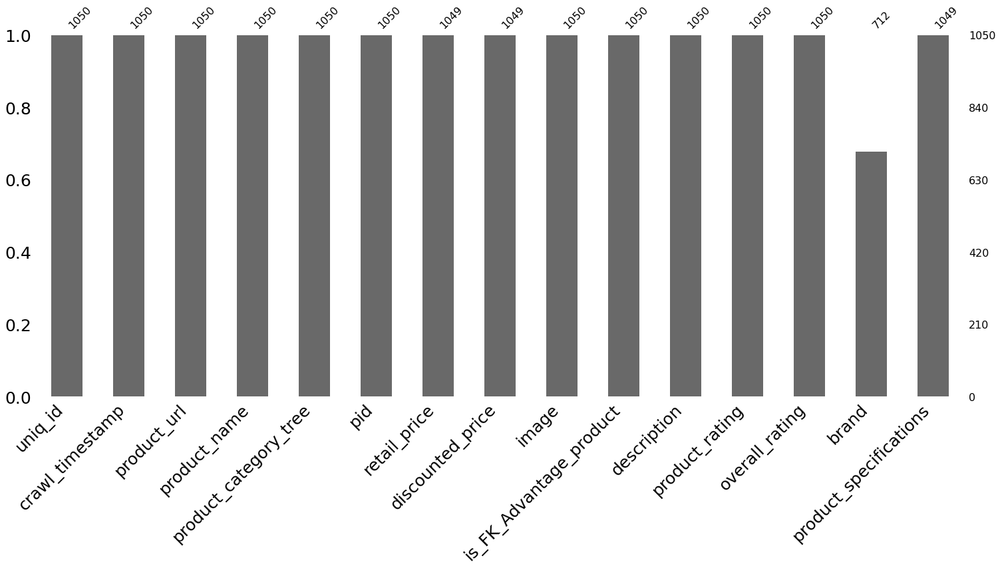

In [7]:
fig = msno.bar(df_data)
fig.tick_params(axis='both', labelsize=25)

In [8]:
df_data["product_category_tree"][0]

'["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]'

**Les niveaux de catégorie sont séparés par les caractères '>>'. La chaîne de caractère commence par les caractères '["' et se termine par les caractères '"]'. Ceci est vrai pour tous les articles comme le confirme le test ci-dessous.**

In [9]:
def check_first2_n_last2_char(row):
    if (row["product_category_tree"][0:2] == '["') and (
        row["product_category_tree"][-2:] == '"]'
    ):
        return True
    else:
        return False

In [10]:
df_data["check"] = df_data.apply(check_first2_n_last2_char, axis=1)

In [11]:
df_data["check"].sum() == df_data.shape[0]

True

In [12]:
def count_sep(row):
    return row["product_category_tree"].count(" >> ")

In [13]:
df_data["count_sep"] = df_data.apply(count_sep, axis=1)

In [14]:
df_data["count_sep"].describe()

count    1050.000000
mean        3.204762
std         1.158126
min         1.000000
25%         2.000000
50%         3.000000
75%         4.000000
max         6.000000
Name: count_sep, dtype: float64

**Chaque separateur de catégorie '>>' est présent entre 6 (max) et 1 (min) fois dans la chaîne de caractère. Il y a donc entre 7 et 2 niveaux de catégories pour chaque article. La fonction suivante permet d'extraire les catégories à partir de la feature 'product_category_tree' :**

In [15]:
def split_categories(category, level):
    cat = category[2:-2].split(" >> ")
    if len(cat) == 7:
        cat = [cat[0], cat[1], cat[2], cat[3], cat[4], cat[5], cat[6]]
    elif len(cat) == 6:
        cat = [cat[0], cat[1], cat[2], cat[3], cat[4], cat[5], "None"]
    elif len(cat) == 5:
        cat = [cat[0], cat[1], cat[2], cat[3], cat[4], "None", "None"]
    elif len(cat) == 4:
        cat = [cat[0], cat[1], cat[2], cat[3], "None", "None", "None"]
    elif len(cat) == 3:
        cat = [cat[0], cat[1], cat[2], "None", "None", "None", "None"]
    elif len(cat) == 2:
        cat = [cat[0], cat[1], "None", "None", "None", "None", "None"]

    return cat[level]

In [16]:
def split_categories_1(category):
    return split_categories(category, 0)


def split_categories_2(category):
    return split_categories(category, 1)


def split_categories_3(category):
    return split_categories(category, 2)


def split_categories_4(category):
    return split_categories(category, 3)


def split_categories_5(category):
    return split_categories(category, 4)


def split_categories_6(category):
    return split_categories(category, 5)


def split_categories_7(category):
    return split_categories(category, 6)

**Je définis une fonction qui récupère les noms des catégories aux 7 niveaux dans chacune des features 'cat_X'.**

In [17]:
def categories_splitter(dataframe):
    dataframe["cat_1"] = dataframe["product_category_tree"].apply(
        split_categories_1
    )
    dataframe["cat_2"] = dataframe["product_category_tree"].apply(
        split_categories_2
    )
    dataframe["cat_3"] = dataframe["product_category_tree"].apply(
        split_categories_3
    )
    dataframe["cat_4"] = dataframe["product_category_tree"].apply(
        split_categories_4
    )
    dataframe["cat_5"] = dataframe["product_category_tree"].apply(
        split_categories_5
    )
    dataframe["cat_6"] = dataframe["product_category_tree"].apply(
        split_categories_6
    )
    dataframe["cat_7"] = dataframe["product_category_tree"].apply(
        split_categories_7
    )

    return dataframe.drop(["product_category_tree"], axis=1)

In [18]:
df_data = categories_splitter(df_data)

In [19]:
df_data.head()

,uniq_id,crawl_timestamp,product_url,product_name,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,check,count_sep,cat_1,cat_2,cat_3,cat_4,cat_5,cat_6,cat_7
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-multicolor-abstract-eyelet-door-curtain/p/itmeg7bkzdgthcts?pid=CRNEG7BKMFFYHQ8Z,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,"Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you get the right amount of sunlight.,Specifications of Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) General Brand Elegance Designed For Door Type Eyelet Model Name Abstract Polyester Door Curtain Set Of 2 Model ID Duster25 Color Multicolor Dimensions Length 213 cm In the Box Number of Contents in Sales Package Pack of 2 Sales Package 2 Curtains Body & Design Material Polyester",No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""value""=>""Elegance""}, {""key""=>""Designed For"", ""value""=>""Door""}, {""key""=>""Type"", ""value""=>""Eyelet""}, {""key""=>""Model Name"", ""value""=>""Abstract Polyester Door Curtain Set Of 2""}, {""key""=>""Model ID"", ""value""=>""Duster25""}, {""key""=>""Color"", ""value""=>""Multicolor""}, {""key""=>""Length"", ""value""=>""213 cm""}, {""key""=>""Number of Contents in Sales Package"", ""value""=>""Pack of 2""}, {""key""=>""Sales Package"", ""value""=>""2 Curtains""}, {""key""=>""Material"", ""value""=>""Polyester""}]}",True,3,Home Furnishing,Curtains & Accessories,Curtains,Elegance Polyester Multicolor Abstract Eyelet Do...,None,None,None
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-towel/p/itmegfzhxbyucwgn?pid=BTWEGFZHGBXPHZUH,Sathiyas Cotton Bath Towel,BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,"Specifications of Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Yellow, Blue) Bath Towel Features Machine Washable Yes Material Cotton Design Self Design General Brand Sathiyas Type Bath Towel GSM 500 Model Name Sathiyas cotton bath towel Ideal For Men, Women, Boys, Girls Model ID asvtwl322 Color Red, Yellow, Blue Size Mediam Dimensions Length 30 inch Width 60 inch In the Box Number of Contents in Sales Package 3 Sales Package 3 Bath Towel",No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Washable"", ""value""=>""Yes""}, {""key""=>""Material"", ""value""=>""Cotton""}, {""key""=>""Design"", ""value""=>""Self Design""}, {""key""=>""Brand"", ""value""=>""Sathiyas""}, {""key""=>""Type"", ""value""=>""Bath Towel""}, {""key""=>""GSM"", ""value""=>""500""}, {""key""=>""Model Name"", ""value""=>""Sathiyas cotton bath towel""}, {""key""=>""Ideal For"", ""value""=>""Men, Women, Boys, Girls""}, {""key""=>""Model ID"", ""value""=>""asvtwl322""}, {""key""

**J'analyse les catégories obtenues : nombres de catégories par niveau et nombre d'articles par catégorie.**

In [20]:
df_data["cat_1"].unique()

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [21]:
df_data["cat_2"].unique()

array(['Curtains & Accessories', 'Baby Bath & Skin', 'Bed Linen',
       'Wrist Watches', 'Living Room Furnishing', 'Bath Linen',
       'Candles & Fragrances', 'Tableware & Cutlery', 'Lighting',
       'JMD Home Furnishing', 'Infant Wear', "Kripa's Home Furnishing",
       'Hair Care', 'Coffee Mugs', 'Network Components',
       'Tablet Accessories', 'Cookware', 'Laptop Accessories', 'Makeup',
       'Combos and Kits', 'Feeding & Nursing', 'Baby Bedding',
       'Kitchen & Dining Linen', 'Containers & Bottles',
       'Consumables & Disposables', 'Wall Decor & Clocks',
       'Table Decor & Handicrafts', 'Flowers, Plants & Vases', 'Software',
       'Showpieces', 'Furniture & Furnishings',
       'Decorative Lighting & Lamps', 'Baby Grooming',
       'Computer Peripherals', 'Cushions, Pillows & Covers', 'Storage',
       'Health Care', 'Body and Skin Care', 'Kitchen Tools',
       'TRUE Home Decor & Festive Needs', 'Living', 'Showpiece',
       'Bar & Glassware', 'Fragrances', "Women'

In [22]:
df_data["cat_3"].unique()

array(['Curtains', 'Baby Bath Towels', 'Bedsheets',
       'Maserati Time Wrist Watches', 'Camerii Wrist Watches',
       'T STAR Wrist Watches', 'Alfajr Wrist Watches',
       'TAG Heuer Wrist Watches', 'Calibro Wrist Watches',
       'Cartier Wrist Watches', 'Lois Caron Wrist Watches',
       'Titan Wrist Watches', 'Srushti Art Jewelry Wrist Watches',
       'Escort Wrist Watches', 'Jack klein Wrist Watches',
       'North Moon Wrist Watches', 'Franck Bella Wrist Watches',
       'Ridas Wrist Watches', 'Skmei Wrist Watches', 'Now Wrist Watches',
       'fastrack Wrist Watches', 'Disney Wrist Watches',
       'Vizion Wrist Watches', 'Elantra Wrist Watches',
       'Marvel Wrist Watches', 'Lenco Wrist Watches',
       "D'Signer Wrist Watches", 'Diwan Sets', 'Duvet Covers',
       'Bath Mats', 'Home Fragrances', 'Jug, Glass & Tray Sets', 'Bulbs',
       'JMD Printed Cushions Cover (Pack of 2, 40 cm*40 ...',
       "Baby Girls' Clothes",
       "Kripa's Printed Cushions Cover (Pack of 2,

/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'Home Furnishing'),
  Text(1, 0, 'Baby Care'),
  Text(2, 0, 'Watches'),
  Text(3, 0, 'Home Decor & Festive Needs'),
  Text(4, 0, 'Kitchen & Dining'),
  Text(5, 0, 'Beauty and Personal Care'),
  Text(6, 0, 'Computers')])

Text(0.5, 0, 'Category')

Text(0, 0.5, 'Count')

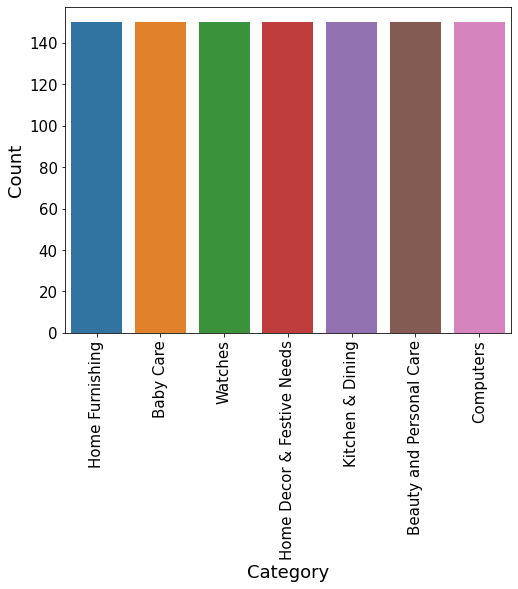

In [23]:
fig = plt.figure(figsize=(8, 6))
ax = sns.countplot(df_data["cat_1"])
plt.xticks(rotation=90)
ax.tick_params(axis='both', labelsize=15)
plt.xlabel('Category', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.show()

**Seule les catégories de niveaux 1 sont en nombre raisonnable pour un clustering vraisemblable étant donné la taille du dataset. Surtout, c'est le seul niveau où les catégories sont peuplées de manière égale comme le montre le graph ci-dessus.**

In [24]:
df_data["cat_2"].value_counts()

Wrist Watches                      149
Laptop Accessories                  87
Infant Wear                         84
Coffee Mugs                         74
Showpieces                          71
Bed Linen                           65
Fragrances                          65
Network Components                  49
Cookware                            27
Table Decor & Handicrafts           27
Combos and Kits                     24
Wall Decor & Clocks                 22
Bath Linen                          21
Curtains & Accessories              19
Makeup                              18
Baby Bedding                        15
Body and Skin Care                  15
Baby & Kids Gifts                   15
Baby Bath & Skin                    14
Kitchen Tools                       14
Kitchen & Dining Linen              14
Decorative Lighting & Lamps         14
Containers & Bottles                13
Cushions, Pillows & Covers          13
Hair Care                            9
Feeding & Nursing        

**J'encode la catégorie de chaque article. La target feature résultante, 'y_cat_num', sera utilisée pour tout le reste de l'étude comme ground truth.**

In [25]:
l_cat = list(set(df_data['cat_1']))
print("catégories : ", l_cat)
y_cat_num = [(1-l_cat.index(df_data.iloc[i]['cat_1'])) for i in range(len(df_data))]

catégories :  ['Home Decor & Festive Needs', 'Beauty and Personal Care', 'Watches', 'Computers', 'Kitchen & Dining', 'Home Furnishing', 'Baby Care']


## 1.2 Pré-traitement du texte : minuscule, tokenisation, stop words et lemmatisation.

**Je définis les fonctions de pré-traitement de la partie NLP. Elles vont permettre la tokenisation, la mise en minuscule, la suppression des stop words ainsi que la lemmatisation. NB : La lemmatisation ne fonctionne que si on applique une détection POS tagging afin d'attribuer les fonctions des mots dans chaque phrase.**

In [28]:
import nltk
nltk.download('omw-1.4')
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk import pos_tag
from wordcloud import WordCloud
import re

# Fonction qui tokenize un texte
def tokenizer_fct(sentence):
    sentence_clean = (
        sentence.replace("-", " ")
        .replace("+", " ")
        .replace("/", " ")
        .replace("#", " ")
        .replace(".", ". ")
        .replace(",", ", ")
    )
    word_tokens = word_tokenize(sentence_clean)
    return word_tokens

# Enrichissement des stopwords de base de NLTK 
stop_w = list(set(stopwords.words("english"))) + [
    "[",
    "]",
    ",",
    ".",
    ":",
    "?",
    "!",
    "(",
    ")",
    "\r",
    "\n",
    "\t",
    ";",
    "flipkart",
    "rs",
    "cm",
    "buy",
    "price",
    "product",
    "free",
    "ship",
    "cash",
    "genuine",
    "delivery",
    "day",
    "replacement",
    "best",
    "online",
    "lowest",
    "shipping",
    "guarantee",
    "great",
    "discount",
    "com",
    "india"
]

# Fonction qui supprime les stopwords ainsi que les mots courts (1 ou 2 caractères)
def stop_word_filter_fct(list_words):
    filtered_w = [w for w in list_words if not w in stop_w]
    filtered_w2 = [w for w in filtered_w if len(w) > 2]
    return filtered_w2
 
# Lower case et alpha
def lower_start_fct(list_words):
    lw = [
        w.lower()
        for w in list_words
        if (not w.startswith("@"))
        and (not w.startswith("http"))
    ]
    return lw


# Lemmatizer (base d'un mot) précédé dun POS tagging
def lemma_fct(list_words):
    lemmatizer = WordNetLemmatizer()
    lem_w = []
    for word, tag in pos_tag(list_words):
        wntag = tag[0].lower()
        wntag = wntag if wntag in ['a', 'r', 'n', 'v'] else None
        if not wntag:
            lemma = word
        else:
            lemma = lemmatizer.lemmatize(word, wntag)
        lem_w.append(lemma)

    return lem_w


# Fonction qui transforme un texte prêt à être vectoriser (BoW)
def transform_bow_fct(desc_text):
    word_tokens = tokenizer_fct(desc_text)
    lw = lower_start_fct(word_tokens)
    sw = stop_word_filter_fct(lw)    
    transf_desc_text = " ".join(sw)
    return transf_desc_text

# Fonction qui transforme un texte avec lemmatisation prêt à être vectoriser (BoW)
def transform_bow_lem_fct(desc_text):
    word_tokens = tokenizer_fct(desc_text)
    lw = lower_start_fct(word_tokens)
    sw = stop_word_filter_fct(lw)
    lem_w = lemma_fct(sw)
    sw_2 = stop_word_filter_fct(lem_w)
    temp = [re.sub(r'\w*\d\w*', '', i) for i in sw_2]
    while("" in temp) :
        temp.remove("")
    transf_desc_text = ' '.join(temp)
    
    return transf_desc_text


# Fonction de préparation du texte pour le Deep learning
def transform_dl_fct(desc_text) :
    word_tokens = tokenizer_fct(desc_text)
    lw = lower_start_fct(word_tokens)
    transf_desc_text = ' '.join(lw)
    return transf_desc_text

# Fonction d'affichage de wordcloud
def plot_wordclouds_from_gb(gb, n_top_words, n_rows=1, figsize=(18,8),
                             backgnd_color='black', cmap='Dark2',
                            random_state=None):

    fig = plt.figure(figsize=figsize)

    for i, tup in enumerate(gb,1):
        n_topic, ser_texts = tup
        ser_freq = pd.Series(nltk.FreqDist(ser_texts))
        
        wc = WordCloud(stopwords=None, background_color=backgnd_color,
                        colormap=cmap, max_font_size=150,
                        random_state=14)
        ser_topic = ser_freq\
            .sort_values(ascending=False)[0:n_top_words]
        wc.generate(' '.join(list(ser_topic.index)))

        n_tot = len(gb)
        n_cols = (n_tot//n_rows)+((n_tot%n_rows)>0)*1
        ax = fig.add_subplot(n_rows,n_cols,i)
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.tight_layout()
        plt.title(n_topic, fontweight='bold')

[nltk_data] Downloading package omw-1.4 to /home/bento/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

**J'applique chaque fonction de pré-traitement à la feature 'description'.**

In [29]:
df_data["sentence_bow_lem"] = df_data["description"].apply(
    lambda x: transform_bow_lem_fct(x)
)

In [30]:
df_data["sentence_bow"] = df_data["description"].apply(
    lambda x: transform_bow_fct(x)
)

In [31]:
df_data["sentence_dl"] = df_data["description"].apply(
    lambda x: transform_dl_fct(x)
)

**Je visualise les 'word clouds' de chaque catégorie et j'identifie les mots inutiles afin d'enrichir le dictionnaire de stop words.**

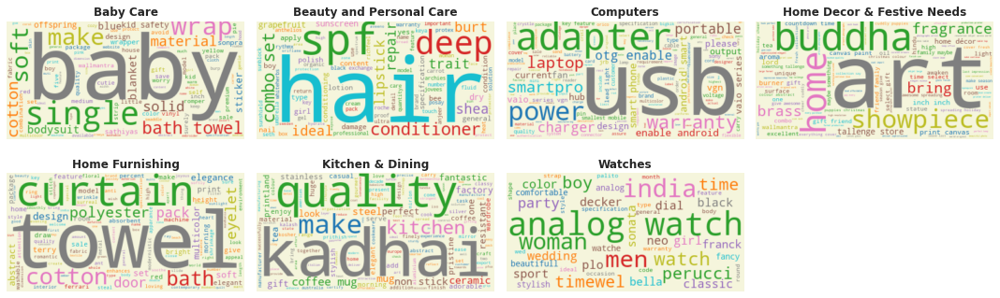

In [330]:
df_data_gb = df_data.groupby("cat_1")["sentence_bow_lem"]
plot_wordclouds_from_gb(df_data_gb, n_top_words=10, n_rows=2, figsize=(15,5),
                        backgnd_color='beige', cmap='tab10', random_state=42)

**Exemple d'une transformation d'un texte très court :**

In [86]:
df_data['description'][5]
df_data["sentence_bow_lem"][5]

'Maserati Time R8851116001 Analog Watch  - For Boys - Buy Maserati Time R8851116001 Analog Watch  - For Boys  R8851116001 Online at Rs.24400 in India Only at Flipkart.com. - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!'

'maserati time analog watch boys maserati time analog watch boys india'

In [89]:
tfidf = TfidfVectorizer(stop_words="english", max_df=0.2, min_df=3)
ctf_transform = tfidf.fit_transform(df_data["sentence_bow_lem"])

In [91]:
transformation = []
for i, el  in enumerate(ctf_transform.todense()[5,:].tolist()[0]):
    if el !=0:
        transformation.append((tfidf.get_feature_names()[i], el))
pd.DataFrame(transformation, columns=['mot', 'tfidf']).sort_values(by='tfidf', ascending=False).head(10)

/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,mot,tfidf
3,time,0.576653
1,boys,0.572881
0,analog,0.400130
4,watch,0.380070
2,india,0.186339


## 1.3 Traitement du texte : approche détection des sujets latents via NMF et LDA

**Je définis une fonction qui vectorise chaque documents du corpus selon une approche CountVectorizer et TFIDF. Les paramètres min_df et max_df correspondent respectivement au nombre de documents (ou fraction du corpus), comportant un mot spécifique, en dessous duquel ce mot est ignoré et au nombre de documents (ou fraction du corpus) au-dessus duquel ce mot est ignoré.**

In [153]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# Fonction qui vectorise un texte préparé : Count Vectorizer et TFIDF
def BoW(min_df, max_df, feat, df_data):
    cvect = CountVectorizer(stop_words="english", max_df=max_df, min_df=min_df)
    ctf = TfidfVectorizer(stop_words="english", max_df=max_df, min_df=min_df)

    feat = "sentence_bow_lem"
    cv_fit = cvect.fit(df_data[feat])
    ctf_fit = ctf.fit(df_data[feat])

    cv_transform = cvect.transform(df_data[feat])
    ctf_transform = ctf.transform(df_data[feat])
    
    return cv_transform, ctf_transform, cvect, ctf

In [331]:
cv_transform, ctf_transform, cvect, ctf = BoW(10, 0.5, "sentence_bow_lem", df_data)

**J'opère une détection, via NMF, de 7 sujets latents correspondant aux 7 catégories de produits.**

In [332]:
nmf = NMF(
    n_components = df_data['cat_1'].nunique(),
    random_state=42,
    #alpha_W=0.1,
    #l1_ratio=0.5,
    init="nndsvd"
).fit(ctf_transform)

In [63]:
def print_top_words(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += " ".join([feature_names[i]
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()

In [334]:
tfidf_feature_names = ctf.get_feature_names_out()
print_top_words(nmf, tfidf_feature_names, n_top_words = 10)

Topic #0: watch analog men india woman dial strap sonata boys resistant
Topic #1: combo set paris stone towel red gift kit soap care
Topic #2: baby girl cotton fabric dress boy neck sleeve print pattern
Topic #3: mug ceramic coffee gift perfect rockmantra prithish love design safe
Topic #4: showpiece handicraft statue india brass gift ganesha lord handcraft stone
Topic #5: usb laptop warranty inch cover feature color model pack light
Topic #6: abstract blanket single double quilt comforter multicolor floral rajasthan blue



In [335]:
transformed_nmf = nmf.transform(ctf_transform)

In [336]:
transformed_nmf.shape

(1050, 7)

**J'opère une détection, via LDA, de 7 sujets latents correspondant aux 7 catégories de produits.**

In [337]:
lda = LatentDirichletAllocation(
    n_components = df_data['cat_1'].nunique(),
    random_state=42
)

In [338]:
lda.fit(cv_transform)

LatentDirichletAllocation(n_components=7, random_state=42)

In [339]:
transformed_lda = lda.transform(cv_transform)

In [340]:
transformed_lda.shape

(1050, 7)

In [341]:
transformed_lda[1]

array([0.05668343, 0.89566423, 0.03742928, 0.00255584, 0.00255736,
       0.00255527, 0.00255459])

**Je définis une petite fonction qui permet de récupérer la classe dont la probabilité est la plus élevée.**

In [54]:
def pool_argmax(row):
    pooled = np.argmax(row)
    return pooled

**Je peux ainsi obtenir le classement/topic de chaque article :**

In [342]:
df_data["lda_pooled_cat"] = np.apply_along_axis(pool_argmax, 1, transformed_lda)
df_data["nmf_pooled_cat"] = np.apply_along_axis(pool_argmax, 1, transformed_nmf)

**Je peux ainsi calculer le score ARI de classification pour les deux méthodes :**

In [343]:
print("ARI for LDA : {}".format(np.round(adjusted_rand_score(y_cat_num, df_data["lda_pooled_cat"]), 4)))
print("ARI for NMF : {}".format(np.round(adjusted_rand_score(y_cat_num, df_data["nmf_pooled_cat"]), 4)))

ARI for LDA : 0.2722
ARI for NMF : 0.3315


**Les résultants sont encourageants et méritent une optimisation.**

In [344]:
cv_feature_names = cvect.get_feature_names_out()
print_top_words(lda, cv_feature_names, n_top_words = 20)

Topic #0: baby girl showpiece fabric cotton boy ideal dress print color specification general sleeve pattern neck pack package feature type wash
Topic #1: pack color feature box number package model sale material cover cotton inch type specification brand general design width dimension towel
Topic #2: watch analog warranty india laptop men adapter woman dial strap skin shape power resistant charger water print digital feature boys
Topic #3: usb mug skin ceramic use type color power material oil specification box general make feature port pack flexible key portable
Topic #4: make light wall design lead gift home size craft perfect material come art feature ensure ceramic rockmantra sticker mug exclusive
Topic #5: set battery combo quality hair laptop cell lapguard include trait image durability assure make offer label specification like size factory
Topic #6: mug coffee perfect gift design tea ceramic make love bring curtain add eyelet special home printland elegant beautifully present 

**Je decide de balayer un espace des hyperparamètre min_df et max_df afin d'obtenir le plus haut score ARI :**

In [345]:
'''
param_max_df = np.arange(0.15, 1.0, 0.05)
param_min_df = np.arange(2, 15, 1)

ARI_gridsearch_lda = np.zeros((len(param_min_df), len(param_max_df)))
ARI_gridsearch_nmf = np.zeros((len(param_min_df), len(param_max_df)))

for i, min_df in enumerate(param_min_df):
    for j, max_df in enumerate(param_max_df):
        cv_transform, ctf_transform, cvect, ctf = BoW(min_df, max_df, "sentence_bow_lem", df_data)
        
        nmf_transform = NMF(
            n_components = df_data['cat_1'].nunique(),
            random_state=42,
            init="nndsvd"
        ).fit_transform(ctf_transform)
        lda_transform = LatentDirichletAllocation(
            n_components = df_data['cat_1'].nunique(),
            random_state=42
        ).fit_transform(cv_transform)
        
        df_data["lda_pooled_cat"] = np.apply_along_axis(pool_argmax, 1, lda_transform)
        df_data["nmf_pooled_cat"] = np.apply_along_axis(pool_argmax, 1, nmf_transform)
        
        ARI_gridsearch_nmf[i][j] = np.round(adjusted_rand_score(y_cat_num, df_data["nmf_pooled_cat"]), 4)
        ARI_gridsearch_lda[i][j] = np.round(adjusted_rand_score(y_cat_num, df_data["lda_pooled_cat"]), 4)
'''

/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/sklearn/decomposition/_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,


In [347]:
'''import pickle

with open('LDA_NMF_gridsearch.pickle', 'wb') as handle:
    pickle.dump([ARI_gridsearch_nmf, ARI_gridsearch_lda], handle)
   
    
import pickle

with open('LDA_NMF_gridsearch_2_cleaner_input.pickle', 'wb') as handle:
    pickle.dump([ARI_gridsearch_nmf, ARI_gridsearch_lda], handle)
    
'''

"import pickle\n\nwith open('LDA_NMF_gridsearch.pickle', 'wb') as handle:\n    pickle.dump([ARI_gridsearch_nmf, ARI_gridsearch_lda], handle)\n"

In [209]:
import pickle
with open('/home/P6/LDA_NMF_gridsearch.pickle', 'rb') as handle:
    ARI_gridsearch_nmf, ARI_gridsearch_lda = pickle.load(handle)

**Le meilleur score (ARI de 0.47) est obtenu pour la méthode NMF avec min_df = 9 et max_df = 0.2**

**Un score ARI de 0.4 est obtenu pour la méthode LDA avec min-df = 8 et max_df = 0.2**

In [358]:
#param_max_df = np.arange(0.15, 1.0, 0.05)
#param_min_df = np.arange(2, 15, 1)
np.max(ARI_gridsearch_nmf)
np.max(ARI_gridsearch_lda)
np.unravel_index(ARI_gridsearch_nmf.argmax(), ARI_gridsearch_nmf.shape)
np.unravel_index(ARI_gridsearch_lda.argmax(), ARI_gridsearch_lda.shape)
param_min_df[7]
param_max_df[1]
param_min_df[6]
param_max_df[1]

0.4672

0.4043

(7, 1)

(6, 1)

9

0.2

8

0.2

## 1.4 Traitement du texte : approche bag-of-word

**Je définis une fonction qui va permettre la réduction des dimensions des features bag-of-word à 2 dimensions, puis le clustering des features réduites en 7 clusters correspondant aux 7 catégories. Les résultats dépendent beaucoup du paramètre de perplexité du TSNE, je l'intègre donc en argument de la fonction, ce qui permettra d'appeler la fonction dans une boucle de recherche de la meilleure valeur de perplexité. Je définis aussi une autre fonction qui permet d'afficher côte-à-côte la réduction à 2 dimensions des features avec une coloration de chaque points en fonction de sa catégorie et les même features réduites coloriées selon le clustering obtenu par k-means.**

In [154]:
import time
from cuml.manifold import TSNE as cuTSNE
from cuml.cluster import KMeans as cuKMeans
from cuml import UMAP as cuUMAP

# Calcul Tsne, détermination des clusters et calcul ARI entre vrais catégorie et n° de clusters
def ARI_fct(features, perplex):
    time1 = time.time()
    num_labels = len(l_cat)
    tsne = cuTSNE(
        n_components=2,
        perplexity=perplex,
        n_neighbors=perplex*3.1,
        n_iter=2000,
        init="random",
        learning_rate=200,
        random_state=42,
        late_exaggeration=1.5
    )
    X_tsne = tsne.fit_transform(features)

    # Détermination des clusters à partir des données après Tsne
    cls = cuKMeans(n_clusters=7, n_init=100, random_state=42)
    cls.fit(X_tsne)
    ARI = np.round(adjusted_rand_score(y_cat_num, cls.labels_), 4)
    time2 = np.round(time.time() - time1, 0)
    print("ARI : ", ARI, "time : ", time2)

    return ARI, X_tsne, cls.labels_


# Visualisation du Tsne selon les vraies catégories et selon les clusters
def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI):
    fig = plt.figure(figsize=(15, 6))

    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_cat_num, cmap="Set1")
    ax.legend(
        handles=scatter.legend_elements()[0],
        labels=l_cat,
        loc="best",
        title="Categorie",
    )
    plt.title("Représentation des catégorie réelles")

    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:, 0], X_tsne[:, 1], c=labels, cmap="Set1")
    ax.legend(
        handles=scatter.legend_elements()[0],
        labels=set(labels),
        loc="best",
        title="Clusters",
    )
    plt.title("Représentation des catégories par clusters")

    plt.show()
    print("ARI : ", ARI)

**Je crée une boucle pour trouver les meilleurs hyperparamètres min_df et max_df pour l'approche bag-of-word :**

In [ ]:
'''
param_max_df = np.arange(0.15, 1.0, 0.05)
param_min_df = np.arange(1, 16, 1)
perplexity = np.arange(5, 51, 2.5)

# [ARI, perplex, min_df, max_df]
ARI_gridsearch_cvect = []
ARI_gridsearch_ctf = []

for i, min_df in enumerate(param_min_df):
    for j, max_df in enumerate(param_max_df):
        cv_transform, ctf_transform, cvect, ctf = BoW(min_df, max_df, "sentence_bow_lem", df_data)
        
        ARI_cv = []
        X_tsne_cv = []
        labels_cv = []
        print("CountVectorizer : ")
        print("-----------------")
        for k, perplex in enumerate(perplexity):
            print("index : ", k)
            ARI, X_tsne, labels = ARI_fct(cv_transform, perplex)
            ARI_cv.append(ARI)
            X_tsne_cv.append(X_tsne)
            labels_cv.append(labels)

        ARI_gridsearch_cvect.append(
            [
                np.max(ARI_cv),
                X_tsne_cv[np.argmax(ARI_cv)],
                perplexity[np.argmax(ARI_cv)],
                min_df,
                max_df
            ]
        )
        
        ARI_ctf = []
        X_tsne_ctf = []
        labels_ctf = []
        print("Tf-idf : ")
        print("--------")
        for k, perplex in enumerate(perplexity):
            print("index : ", k)
            ARI, X_tsne, labels = ARI_fct(ctf_transform, perplex)
            ARI_ctf.append(ARI)
            X_tsne_ctf.append(X_tsne)
            labels_ctf.append(labels)
        
        ARI_gridsearch_ctf.append(
            [
                np.max(ARI_ctf),
                X_tsne_ctf[np.argmax(ARI_ctf)],
                perplexity[np.argmax(ARI_ctf)],
                min_df,
                max_df
            ]
        )
'''

CountVectorizer : 
-----------------
index :  0
ARI :  0.3458 time :  3.0
index :  1
ARI :  0.2718 time :  2.0
index :  2
ARI :  0.3067 time :  2.0
index :  3
ARI :  0.3231 time :  2.0
index :  4
ARI :  0.2745 time :  1.0
index :  5
ARI :  0.2696 time :  2.0
index :  6
ARI :  0.3437 time :  1.0
index :  7
ARI :  0.2657 time :  1.0
index :  8
ARI :  0.2864 time :  1.0
index :  9
ARI :  0.29 time :  1.0
index :  10
ARI :  0.2981 time :  2.0
index :  11
ARI :  0.2907 time :  2.0
index :  12
ARI :  0.3212 time :  2.0
index :  13
ARI :  0.2737 time :  2.0
index :  14
ARI :  0.2543 time :  2.0
index :  15
ARI :  0.2532 time :  1.0
index :  16
ARI :  0.2636 time :  2.0
index :  17
ARI :  0.2433 time :  2.0
index :  18
ARI :  0.242 time :  2.0
Tf-idf : 
--------
index :  0
ARI :  0.4227 time :  1.0
index :  1
ARI :  0.3795 time :  1.0
index :  2
ARI :  0.5015 time :  2.0
index :  3
ARI :  0.4533 time :  1.0
index :  4
ARI :  0.4338 time :  2.0
index :  5
ARI :  0.4323 time :  2.0
index :  6
AR

In [375]:
'''import pickle

with open('cv_ctf_gridsearch_2_cleaner_input.pickle', 'wb') as handle:
    pickle.dump([ARI_gridsearch_cvect, ARI_gridsearch_ctf], handle)'''

In [150]:
with open('cv_ctf_gridsearch_2_cleaner_input.pickle', 'rb') as handle:
    ARI_gridsearch_cvect, ARI_gridsearch_ctf = pickle.load(handle)

In [151]:
max(ARI_gridsearch_cvect, key=lambda x: x[0])
max(ARI_gridsearch_ctf, key=lambda x: x[0])

[0.4759,
 array([[   1.7500454,  370.3711   ],
        [-315.71893  ,  184.2665   ],
        [-257.00583  ,  185.81076  ],
        ...,
        [ 215.34679  ,   23.279827 ],
        [ 226.61705  ,   82.47248  ],
        [ 205.26765  ,   44.3398   ]], dtype=float32),
 20.0,
 10,
 0.15]

[0.555,
 array([[-380.0228  ,   58.694687],
        [-440.01556 , -424.99158 ],
        [-370.47687 , -397.1434  ],
        ...,
        [-146.01689 ,  -64.323814],
        [-167.1146  ,  -11.571466],
        [-136.37225 ,  -33.618042]], dtype=float32),
 15.0,
 3,
 0.2]

**L'approche TFIDF produit les meilleurs résultats avec un ARI de 0.56 pour un min_df = 3 et max_df = 0.2**

**L'approche count vectorizer produit un ARI de 0.48 pour min_df = 10 et max_df = 0.15**

**Je choisis ces paramètres pour le tracé des graphs :**

In [155]:
cv_transform, ctf_transform, cvect, ctf = BoW(10, 0.15, "sentence_bow_lem", df_data)

In [156]:
ARI_cv = []
X_tsne_cv = []
labels_cv = []
perplexity = np.arange(5, 51, 2.5)
print("CountVectorizer : ")
print("-----------------")
for k, perplex in enumerate(perplexity):
    print("index : ", k)
    ARI, X_tsne, labels = ARI_fct(cv_transform, perplex)
    ARI_cv.append(ARI)
    X_tsne_cv.append(X_tsne)
    labels_cv.append(labels)
print()

CountVectorizer : 
-----------------
index :  0
ARI :  0.3969 time :  4.0
index :  1
ARI :  0.3177 time :  2.0
index :  2
ARI :  0.3134 time :  3.0
index :  3
ARI :  0.4366 time :  3.0
index :  4
ARI :  0.3191 time :  3.0
index :  5
ARI :  0.4118 time :  3.0
index :  6
ARI :  0.4596 time :  3.0
index :  7
ARI :  0.3985 time :  3.0
index :  8
ARI :  0.3422 time :  3.0
index :  9
ARI :  0.3738 time :  3.0
index :  10
ARI :  0.3645 time :  3.0
index :  11
ARI :  0.3517 time :  2.0
index :  12
ARI :  0.3364 time :  3.0
index :  13
ARI :  0.3227 time :  3.0
index :  14
ARI :  0.2761 time :  3.0
index :  15
ARI :  0.2731 time :  3.0
index :  16
ARI :  0.333 time :  3.0
index :  17
ARI :  0.3112 time :  3.0
index :  18
ARI :  0.2853 time :  3.0



In [157]:
cv_transform, ctf_transform, cvect, ctf = BoW(3, 0.2, "sentence_bow_lem", df_data)

In [158]:
ARI_ctf = []
X_tsne_ctf = []
labels_ctf = []
print("Tf-idf : ")
print("--------")
for k, perplex in enumerate(perplexity):
    print("index : ", k)
    ARI, X_tsne, labels = ARI_fct(ctf_transform, perplex)
    ARI_ctf.append(ARI)
    X_tsne_ctf.append(X_tsne)
    labels_ctf.append(labels)

Tf-idf : 
--------
index :  0
ARI :  0.3797 time :  3.0
index :  1
ARI :  0.3665 time :  3.0
index :  2
ARI :  0.4574 time :  3.0
index :  3
ARI :  0.4661 time :  3.0
index :  4
ARI :  0.5031 time :  3.0
index :  5
ARI :  0.394 time :  3.0
index :  6
ARI :  0.4287 time :  2.0
index :  7
ARI :  0.5172 time :  3.0
index :  8
ARI :  0.4154 time :  2.0
index :  9
ARI :  0.407 time :  3.0
index :  10
ARI :  0.394 time :  3.0
index :  11
ARI :  0.4207 time :  3.0
index :  12
ARI :  0.3765 time :  3.0
index :  13
ARI :  0.3487 time :  3.0
index :  14
ARI :  0.371 time :  3.0
index :  15
ARI :  0.3535 time :  3.0
index :  16
ARI :  0.4338 time :  3.0
index :  17
ARI :  0.3935 time :  3.0
index :  18
ARI :  0.3423 time :  3.0


**Je ne retrouve pas tout à fait les résultats obtenus pour le gridsearch car l'initialisation de TSNE est aléatoire et les résultats sont donc assez variables selon la réduction de dimensions opérée.**

Text(0.5, 0, 'perplexity')

Text(0, 0.5, 'ARI')

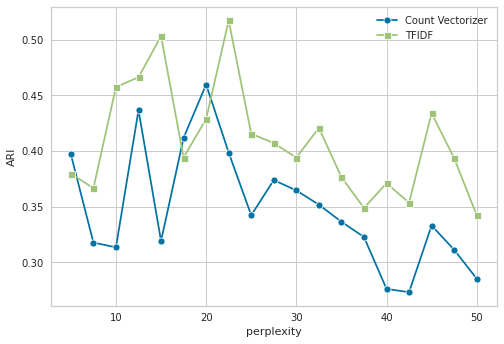

In [160]:
p = sns.lineplot(x=perplexity, y=ARI_cv, marker="o")
p = sns.lineplot(x=perplexity, y=ARI_ctf, marker="s")
plt.legend(labels=["Count Vectorizer", "TFIDF"])
p.set_xlabel("perplexity")
p.set_ylabel("ARI")

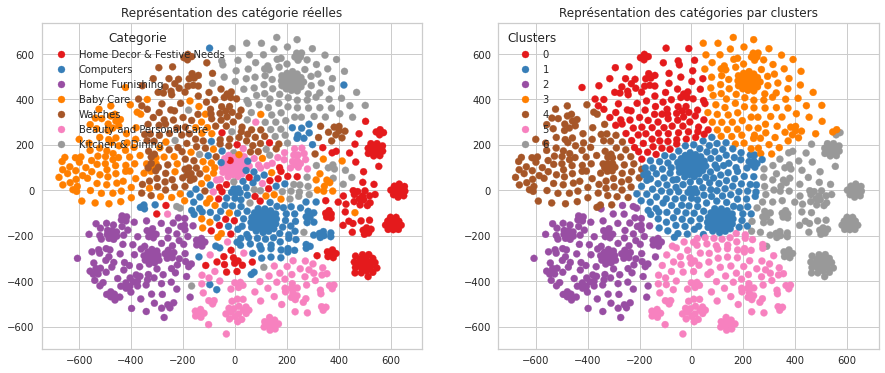

ARI :  0.4596


In [161]:
i = np.argmax(ARI_cv)
TSNE_visu_fct(X_tsne_cv[i], y_cat_num, labels_cv[i], ARI_cv[i])

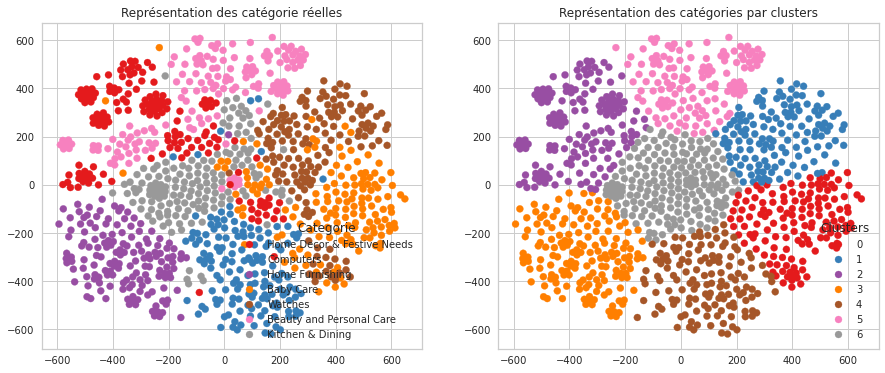

ARI :  0.5172


In [162]:
j = np.argmax(ARI_ctf)
TSNE_visu_fct(X_tsne_ctf[j], y_cat_num, labels_ctf[j], ARI_ctf[j])

In [164]:
encoder = LabelEncoder()
encoded_Y = encoder.fit_transform(df_data["cat_1"])

In [165]:
conf_mat = confusion_matrix(encoded_Y, labels_ctf[np.argmax(ARI_ctf)])
print(conf_mat)

[[ 98  19   2   0   8   1  22]
 [  6   1   0   1 116   3  23]
 [  0   0  41   0   0 100   9]
 [  2   1  11  16   6  17  97]
 [ 27 112   0   0   3   4   4]
 [  4   0 104   0   2   8  32]
 [  0   0   0 148   1   0   1]]


**Je définis une fonction qui réaligne les catégories afin que les labels obtenus par clustering k-means et les vrais labels correspondent. Il est ainsi possible de calculer une accuracy.**

In [166]:
def conf_mat_transform(y_true, y_pred) :
    conf_mat = confusion_matrix(y_true, y_pred)
    
    # Correspondance des classes avec argmax
    corresp = np.argmax(conf_mat, axis=0)
    
    print ("Correspondance des clusters : ", corresp)
    # y_pred_transform = np.apply_along_axis(correspond_fct, 1, y_pred)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

In [167]:
cls_labels_transform = conf_mat_transform(encoded_Y, labels_ctf[np.argmax(ARI_ctf)])
conf_mat = confusion_matrix(encoded_Y, cls_labels_transform)
print(conf_mat)
print()
print(classification_report(encoded_Y, cls_labels_transform))

Correspondance des clusters :  [0 4 5 6 1 2 3]
[[ 98   8   1  22  19   2   0]
 [  6 116   3  23   1   0   1]
 [  0   0 100   9   0  41   0]
 [  2   6  17  97   1  11  16]
 [ 27   3   4   4 112   0   0]
 [  4   2   8  32   0 104   0]
 [  0   1   0   1   0   0 148]]

              precision    recall  f1-score   support

           0       0.72      0.65      0.68       150
           1       0.85      0.77      0.81       150
           2       0.75      0.67      0.71       150
           3       0.52      0.65      0.57       150
           4       0.84      0.75      0.79       150
           5       0.66      0.69      0.68       150
           6       0.90      0.99      0.94       150

    accuracy                           0.74      1050
   macro avg       0.75      0.74      0.74      1050
weighted avg       0.75      0.74      0.74      1050



**Par curiosité, je regarde les descriptions de quelques articles afin d'essayer de comprendre pourquoi ils sont mal classés.**

In [171]:
indices_ctf = np.arange(len(cls_labels_transform))
wrong_class = (encoded_Y != cls_labels_transform)
indices_wrong_class = indices_ctf[wrong_class]
indices_wrong_class.shape

for i in range(10):
    print("Article No {}".format(indices_wrong_class[i]))
    df_data.iloc[indices_wrong_class[i]]["description"]
    print("TFIDF :")
    df_data.iloc[indices_wrong_class[i]]["sentence_bow_lem"]

(275,)

Article No 7


'T STAR UFT-TSW-005-BK-BR Analog Watch  - For Boys\r\n                         Price: Rs. 399\r\n\t\t\t\t\r\n\t\t\tWhether you are on your way to work or travelling abroad with family, lifestyle accessories like watches, wallets and belts help to add a touch of sophistication and class to your otherwise mundane and regular daily wear. When it all comes down to it, suave leather belts and intricately designed and finished timepieces are what separate you from the rest.\r\nWhether you are on your way to work or travelling abroad with family, lifestyle accessories like watches, wallets and belts help to add a touch of sophistication and class to your otherwise mundane and regular daily wear. When it all comes down to it, suave leather belts and intricately designed and finished timepieces are what separate you from the rest.'

TFIDF :


'star uft tsw analog watch boys whether way work travel abroad family lifestyle accessory like watch wallet belt help add touch sophistication class otherwise mundane regular daily wear come suave leather belt intricately design finish timepiece separate rest whether way work travel abroad family lifestyle accessory like watch wallet belt help add touch sophistication class otherwise mundane regular daily wear come suave leather belt intricately design finish timepiece separate rest'

Article No 35


'Buy Riva Carpets Cotton Free Bath Mat Classic Loop Shag Bathmat_RI-527 at Rs. 1799 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery!'

TFIDF :


'riva carpet cotton bath mat classic loop shag bathmat_ri'

Article No 36


'Myesquire Ceramic Burner Pot Lemongrass Liquid Air Freshener (30 ml)\r\n                         Price: Rs. 245\r\n\t\t\t\t\r\n\t\t\tIlluminate Every Corner Of Your Living Room In Style With This Home Fragrance Electric Burner Combo With Fragrance That Is Brought To You By Myesquire. This Is A Very Unique, Useful And Value for Money Product For Home Decoration And Fragrance. This Unique Combo Contains Aroma Burner With All Accessories and is ready to use . Put A Small Amount 1-2 Tea Spoon Of Aroma Oil On The Bowl Surface And Light The Tea Light and After Few Minutes As The Oil Heats Up, The Fragrance Will Spread In The Room. And You Will Be All Set To Enjoy The Captivating Aroma. Keep It Away From Children As Surface Becomes Hot.\r\nIlluminate Every Corner Of Your Living Room In Style With This Home Fragrance Electric Burner Combo With Fragrance That Is Brought To You By Myesquire. This Is A Very Unique, Useful And Value for Money Product For Home Decoration And Fragrance. This Unique

TFIDF :


'myesquire ceramic burner pot lemongrass liquid air freshener illuminate every corner living room style home fragrance electric burner combo fragrance bring myesquire unique useful value money home decoration fragrance unique combo contains aroma burner accessory ready use put small amount tea spoon aroma oil bowl surface light tea light minute oil heat fragrance spread room set enjoy captivate aroma keep away child surface becomes hot illuminate every corner living room style home fragrance electric burner combo fragrance bring myesquire unique useful value money home decoration fragrance unique combo contains aroma burner accessory ready use put small amount tea spoon aroma oil bowl surface light tea light minute oil heat fragrance spread room set enjoy captivate aroma keep away child surface becomes hot'

Article No 37


'Key Features of Dungri India Craft Ducjug010-ducgl012-2 Jug Glass Set Jug: Height- 8 inches, Dia - 4.2 inches, Depth 7.5 inches, Width 7 inches,capacity 1744 ml, Weight - 430 Grams,Dungri India Craft Ducjug010-ducgl012-2 Jug Glass Set (Copper) Price: Rs. 1,399 Copper Utensils And Serving Copper Ware Helped To Prevent The Spread Of Diseases. In Many Tests It Showed That 99.9% Of The Bacteria On Copper Alloy Surfaces (With 65% Or Greater Copper Content) Were Eliminated Within 2 Hours Of Exposure. According To Research At Southampton University In The U.K., Mrsa Microbes Remain Alive On Stainless Steel Surfaces For Up To Three Days, Whereas The Same Microbes On A Copper Surface Are Eliminated Within 90 Minutes. These Copper Serving Ware Are Preferred Because It Is Durable And It Has Excellent Characteristics. The Ageless Use Of Copper Bears Testimony To Its Myriad Virtues And Everlasting Appeal. Its Therapeutic Value Has Been Handed Down To Us Through The Ages. In Fact, Water Stored In C

TFIDF :


'key feature dungri india craft jug glass set jug height inch dia inch depth inch width inch capacity weight gram dungri india craft jug glass set copper copper utensil serve copper ware help prevent spread disease many test show bacteria copper alloy surface greater copper content eliminate within hour exposure accord research southampton university mrsa microbe remain alive stainless steel surface three whereas microbes copper surface eliminate within minute copper serve ware preferred durable excellent characteristic ageless use copper bear testimony myriad virtue everlasting appeal therapeutic value hand age fact water store copper ware virtually elixir life purify helps regulate digestion cardiac order basis good health practice ayurveda rishits old vedic time care tips clean copperware hand avoid dishwasher detergent cause oxidation lead permanat damage use solution equal quantity vinegar lemon juice salt dilute water time use regularly avoid scratchy cleaner like steel wool simp

Article No 38


'Key Features of BFT 6 W LED Bulb Pack of 1 Bulb,BFT 6 W LED Bulb (White) Price: Rs. 350 Introducing new technology in led lighting LED filament. Best suited for chandeliers table lamps and light fixtures in general as it spreads light 360-degrees,Specifications of BFT 6 W LED Bulb (White) General Brand BFT Model Number BFTCW6 Body and Design Features Material Glass Bulb Base B22 Lighting Features Light Color White Bulb Type LED Lumen 700 Power Features Power Consumption 6 W In the Box Sales Package 1 Bulb Pack of 1'

TFIDF :


'key feature bft lead bulb pack bulb bft lead bulb white introduce new technology lead light lead filament suit chandelier table lamp light fixture general spread light degree specification bft lead bulb white general brand bft model number body design feature material glass bulb base light feature light color white bulb type lead lumen power feature power consumption box sale package bulb pack'

Article No 52


'Key Features of Cookart Elegant S.S. Handi With Hot Pot Pack of 4 Casserole Set Pack of 4 Cook and Serve Casserole,Cookart Elegant S.S. Handi With Hot Pot Pack of 4 Casserole Set (1500 ml, 2.25 L) Price: Rs. 699 Cookart introduces a perfect fusion of style and durability, this 4 piece stainless steel casserole & handi set will be a perfect addition to your kitchen. This set is made of the finest quality stainless steel material. The high quality material also take care of your health and hygiene. Handi Capacity: 0.500 ML, 0.750ML, 1 L,Specifications of Cookart Elegant S.S. Handi With Hot Pot Pack of 4 Casserole Set (1500 ml, 2.25 L) Care and Use Features Microwave Safe No General Brand Cookart Casserole Type Cook and Serve Casserole Model Number ECH1 Type Casserole Set Model Name Elegant S.S. Handi With Hot Pot Material Stainless Steel Capacity 1500 ml, 2.25 L Color Silver Body and Design Features Lid Included Yes Non-stick Coating No In the box Sales Package 1 Casserole, 3 Handi Pack

TFIDF :


'key feature cookart elegant handi hot pot pack casserole set pack cook serve casserole cookart elegant handi hot pot pack casserole set cookart introduces perfect fusion style durability piece stainless steel casserole handi set perfect addition kitchen set make finest quality stainless steel material high quality material also take care health hygiene handi capacity specification cookart elegant handi hot pot pack casserole set care use feature microwave safe general brand cookart casserole type cook serve casserole model number type casserole set model name elegant handi hot pot material stainless steel capacity color silver body design feature lid include yes non stick coat box sale package casserole handi pack'

Article No 56


'Buy Borse N16 Make Up And Jewellery Vanity Case for Rs.680 online. Borse N16 Make Up And Jewellery Vanity Case at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.'

TFIDF :


'borse make jewellery vanity case borse make jewellery vanity case'

Article No 66


'Specifications of CHHOTE JANAB COZY MATTRESS PROTECTOR(SET OF 2) (MULTI) Baby Mattress Features Material COTTON General Brand CHHOTE JANAB Type WATERPROOF Model Name COZY MATTRESS PROTECTOR(SET OF 2) Pattern PLAIN Model ID ED104 Color MULTI Additional Features SOFT AND COMFORTABLE, WATERPROOF, SET OF 2, COLOUR MAY BE VARY. In the Box Sales Package 2 MATTRESS'

TFIDF :


'specification chhote janab cozy mattress protector set multi baby mattress feature material cotton general brand chhote janab type waterproof model name cozy mattress protector set pattern plain model color multi additional feature soft comfortable waterproof set colour may vary box sale package mattress'

Article No 67


'Key Features of Prime Printed 4 Seater Table Cover Length 60 inch/152 cm Width 40 inch/101 cm,Prime Printed 4 Seater Table Cover (Multicolor, PVC) Price: Rs. 499 Prime Center Table Cover Printed 4 Seater,Specifications of Prime Printed 4 Seater Table Cover (Multicolor, PVC) In The Box Number of Contents in Sales Package Pack of 1 General Brand Prime Type Table Cover Model Name 0.281 Material PVC Model ID 281 Color Multicolor Dimensions Weight 250 g Length 60 inch / 152 cm Width 40 inch / 101 cm Seating Capacity 4 Seater'

TFIDF :


'key feature prime printed seater table cover length inch width inch prime print seater table cover multicolor pvc prime center table cover print seater specification prime print seater table cover multicolor pvc box number content sale package pack general brand prime type table cover model name material pvc model color multicolor dimension weight length inch width inch seating capacity seater'

Article No 68


'Specifications of SKI WINNER GIFT SET SKYBLUE02 2 Containers Lunch Box (550 ml) General Series LOW Model Name WINNER GIFT SET SKYBLUE02 Lunch Box Features Lunch Box Material Plastic Number of Containers 2 Lunch Box Capacity 550 ml In the Box 1LUNCH BOS 550ML, 1 WATER BOTTLE'

TFIDF :


'specification ski winner gift set container lunch box general series low model name winner gift set lunch box feature lunch box material plastic number container lunch box capacity box bos water bottle'

## 1.5 Traitement du texte : approche Word2Vec

**Pour ce projet, j'ai commencé une initiation à la programmation orienté objet. C'est pourquoi pour Word2Vec je définis une classe w2v_ qui rassemble les paramètres et les méthodes utiles pour cette section. La méthode 'build_train_w2v_model' charge le modèle pré-entrainé 'GoogleNews-vectors-negative300' avec l'argument lockf = 1.0, ce qui permet aux vecteurs communs entre le vocabulaire de notre corpus et le vocabulaire de GoogleNews de continuer à être entrainé sur notre corpus.**

In [31]:
#!pip install gensim -U

In [111]:
w2v_size=300
w2v_window=7
w2v_min_count=1
w2v_epochs=100
maxlen = 50 # adapt to length of sentences

sentences = df_data['sentence_bow_lem']
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [73]:
class w2v_:
    def __init__(self, w2v_size=300, w2v_window=7, w2v_min_count=1, w2v_epochs=100, maxlen=50):
        self.w2v_size = w2v_size
        self.w2v_window = w2v_window
        self.maxlen = maxlen
        self.w2v_min_count = w2v_min_count
        self.w2v_epochs = w2v_epochs
        
    def update_params(self, w2v_window, maxlen):
        self.w2v_window = w2v_window
        self.maxlen = maxlen
        
    def build_train_w2v_model(self):
        print("Model building and training...")
        self.w2v_model = gensim.models.Word2Vec(
            min_count=self.w2v_min_count, 
            window=self.w2v_window,
            vector_size=self.w2v_size,
            seed=42,
            workers=2
        )
        self.w2v_model.build_vocab(sentences)
        self.w2v_model.wv.vectors_lockf = np.ones(len(self.w2v_model.wv), dtype=np.float32)
        self.w2v_model.wv.intersect_word2vec_format('GoogleNews-vectors-negative300.bin',
                                lockf=1.0,
                                binary=True)
        self.w2v_model.train(
            sentences,
            total_examples=self.w2v_model.corpus_count, 
            epochs=self.w2v_epochs
        )
        self.model_vectors = self.w2v_model.wv
        self.w2v_words = self.model_vectors.index_to_key
        print("Vocabulary size: %i" % len(self.w2v_words))
        print("Word2Vec trained")
        
    def fit_tokenizer(self):
        print("Fit Tokenizer ...")
        self.tokenizer = Tokenizer()
        self.tokenizer.fit_on_texts(sentences)
        self.x_sentences = pad_sequences(
            self.tokenizer.texts_to_sequences(sentences),
            maxlen=self.maxlen,
            padding='post'
        ) 
        self.num_words = len(self.tokenizer.word_index) + 1
        print("Number of unique words: %i" % self.num_words)
        
    def create_embedding_matrix(self):
        # Création de la matrice d'embedding
        print("Create Embedding matrix ...")
        self.word_index = self.tokenizer.word_index
        self.vocab_size = len(self.word_index) + 1
        self.embedding_matrix = np.zeros((self.vocab_size, self.w2v_size))
        i=0
        j=0

        for word, idx in self.word_index.items():
            i +=1
            if word in self.w2v_words:
                j +=1
                embedding_vector = self.model_vectors[word]
                if embedding_vector is not None:
                    self.embedding_matrix[idx] = self.model_vectors[word]

        word_rate = np.round(j/i,4)
        print("Word embedding rate : ", word_rate)
        print("Embedding matrix: %s" % str(self.embedding_matrix.shape))
        
    def create_keras_model(self):
        # Création du modèle
        tf.keras.backend.clear_session()
        #input=Input(shape=(len(self.x_sentences), self.maxlen),dtype='float64')
        self.word_input=Input(shape=(self.maxlen,),dtype='float64')  
        self.word_embedding=Embedding(input_dim=self.vocab_size,
                                 output_dim=self.w2v_size,
                                 weights = [self.embedding_matrix],
                                 input_length=self.maxlen)(self.word_input)
        self.word_vec=GlobalAveragePooling1D()(self.word_embedding)  
        self.embed_model = Model([self.word_input],self.word_vec)

        print(self.embed_model.summary())
        
    def predict(self):
        self.embeddings_w2v = self.embed_model.predict(self.x_sentences)
        return self.embeddings_w2v

Num GPUs Available:  1


2022-09-09 12:58:08.652865: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2022-09-09 12:58:08.654039: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2022-09-09 12:58:08.654628: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.


**Je définis une boucle qui va balayer quelques hyperparamètres (window et maxlen) afin d'optimiser un peu les résultats :**

In [45]:
'''
#w2v_window_range = np.arange(3, 15, 2)
#max_len_range = np.arange(5, 50, 5)
w2v_window_range = np.arange(5, 11, 2)
max_len_range = np.arange(50, 160, 10)
#results: [ARI, perplex, window, max_len]
results_2 = []
w2v = w2v_()
for window in w2v_window_range:
    for max_len in max_len_range:
        w2v.update_params(window, max_len)
        w2v.build_train_w2v_model()
        w2v.fit_tokenizer()
        w2v.create_embedding_matrix()
        w2v.create_keras_model()
        embeddings_w2v = w2v.predict()
        
        ARI_w2v = []
        X_tsne_w2v = []
        labels_w2v = []
        perplexity = np.arange(5, 51, 5)

        print("Word2Vec : ")
        print("--------")
        for perplex in perplexity:
            ARI, X_tsne, labels = ARI_fct(embeddings_w2v, perplex)
            ARI_w2v.append(ARI)
            X_tsne_w2v.append(X_tsne)
            labels_w2v.append(labels)
            
        results_2.append(
            [
                np.max(ARI_w2v),
                perplexity[np.argmax(ARI_w2v)],
                window,
                max_len
            ]
        )
'''

Model building and training...
Vocabulary size: 4506
Word2Vec trained
Fit Tokenizer ...
Number of unique words: 4507
Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (4507, 300)
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 50)]              0         
_________________________________________________________________
embedding (Embedding)        (None, 50, 300)           1352100   
_________________________________________________________________
global_average_pooling1d (Gl (None, 300)               0         
Total params: 1,352,100
Trainable params: 1,352,100
Non-trainable params: 0
_________________________________________________________________
None
Word2Vec : 
--------
ARI :  0.2505 time :  2.0
ARI :  0.2246 time :  2.0
ARI :  0.2467 time :  2.0
ARI :  0.2973 time :  2.0
ARI :  0.2915 time :  2.0
ARI :  0.2951 time :  2

In [42]:
'''import pickle

with open('w2v_gridsearch.pickle', 'wb') as handle:
    pickle.dump(results, handle)'''

In [61]:
'''import pickle

with open('w2v_gridsearch_2.pickle', 'wb') as handle:
    pickle.dump(results_2, handle)'''

In [43]:
import pickle

with open('w2v_gridsearch_2.pickle', 'rb') as handle:
    results_2 = pickle.load(handle)

In [43]:
max(results, key=lambda x: x[0])

[0.3216, 25.0, 5, 45]

In [46]:
max(results_2, key=lambda x: x[0])

[0.3825, 40, 5, 120]

**Les meilleurs résultats sont obtenus pour window = 5 et maxlen = 120.** 

In [115]:
w2v_optimal = w2v_(w2v_size=300, w2v_window=5, w2v_min_count=1, w2v_epochs=100, maxlen=120)
w2v_optimal.update_params(5, 120)
w2v_optimal.build_train_w2v_model()
w2v_optimal.fit_tokenizer()
w2v_optimal.create_embedding_matrix()
w2v_optimal.create_keras_model()
embeddings_w2v = w2v_optimal.predict()

ARI_w2v = []
X_tsne_w2v = []
labels_w2v = []
perplexity = np.arange(5, 51, 5)

print("Word2Vec : ")
print("--------")
for perplex in perplexity:
    ARI, X_tsne, labels = ARI_fct(embeddings_w2v, perplex)
    ARI_w2v.append(ARI)
    X_tsne_w2v.append(X_tsne)
    labels_w2v.append(labels)

Model building and training...
Vocabulary size: 4171
Word2Vec trained
Fit Tokenizer ...
Number of unique words: 4172
Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (4172, 300)
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 120)]             0         
                                                                 
 embedding (Embedding)       (None, 120, 300)          1251600   
                                                                 
 global_average_pooling1d (G  (None, 300)              0         
 lobalAveragePooling1D)                                          
                                                                 
Total params: 1,251,600
Trainable params: 1,251,600
Non-trainable params: 0
_________________________________________________________________
None
33/33 [==============================] - 1

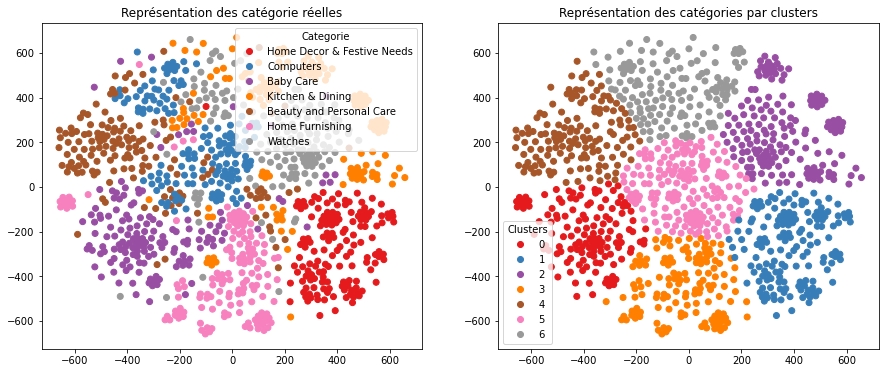

ARI :  0.4322


In [116]:
j = np.argmax(ARI_w2v)
TSNE_visu_fct(X_tsne_w2v[j], y_cat_num, labels_w2v[j], ARI_w2v[j])

**Le facteur aléatoire intervient dans l'ARI obtenu ci-dessus (0.43). Les performances sont de l'ordre de l'approche bag-of-word.**

## 1.6 Traitement du texte : approche BERT

In [120]:
# Bert
import transformers
from transformers import *

**Je définis une classe dont les paramètres et les méthodes vont permettre de réaliser l'approche par un modèle de type BERT.**

In [121]:
class bert_:
    def __innit__(self, max_length = 10, batch_size = 50, model_type = 'bert-large-uncased'):
        self.max_length = max_length
        self.batch_size = batch_size
        self.model_type = model_type

    def update_params(self, max_len, batch_s):
        self.max_length = max_len
        self.batch_size = batch_s
        
    # Fonction de préparation des sentences
    def bert_inp_fct(self, sentences, bert_tokenizer, max_length):
        self.input_ids = []
        self.token_type_ids = []
        self.attention_mask = []
        self.bert_inp_tot = []

        for sent in sentences:
            self.bert_inp = bert_tokenizer.encode_plus(sent,
                                                  add_special_tokens = True,
                                                  max_length = max_length,
                                                  #pad_to_max_length=True,
                                                  padding='max_length',
                                                  return_attention_mask = True, 
                                                  return_token_type_ids=True,
                                                  truncation=True,
                                                  return_tensors="tf")

            self.input_ids.append(self.bert_inp['input_ids'][0])
            self.token_type_ids.append(self.bert_inp['token_type_ids'][0])
            self.attention_mask.append(self.bert_inp['attention_mask'][0])
            self.bert_inp_tot.append((self.bert_inp['input_ids'][0], 
                                 self.bert_inp['token_type_ids'][0], 
                                 self.bert_inp['attention_mask'][0]))

        self.input_ids = np.asarray(self.input_ids)
        self.token_type_ids = np.asarray(self.token_type_ids)
        self.attention_mask = np.array(self.attention_mask)

        return self.input_ids, self.token_type_ids, self.attention_mask, self.bert_inp_tot


    # Fonction de création des features
    def feature_BERT_fct(self, model, model_type, sentences, max_length, b_size, mode='HF'):
        self.batch_size = b_size
        self.batch_size_pred = b_size
        self.bert_tokenizer = transformers.AutoTokenizer.from_pretrained(model_type)
        time1 = time.time()
        if (len(sentences) % self.batch_size !=0):
            num_steps = len(sentences)//self.batch_size + 1
        else:
            num_steps = len(sentences)//self.batch_size
        for step in range(num_steps):
            if (step*self.batch_size < len(sentences)) and (len(sentences) % self.batch_size !=0):
                idx = step*self.batch_size
                self.input_ids, self.token_type_ids, self.attention_mask, self.bert_inp_tot = self.bert_inp_fct(sentences[idx:idx+self.batch_size], 
                                                                          self.bert_tokenizer, max_length)
            elif (step*self.batch_size > len(sentences)) and (len(sentences) % self.batch_size !=0):
                idx = step*self.batch_size
                self.input_ids, self.token_type_ids, self.attention_mask, self.bert_inp_tot = self.bert_inp_fct(sentences[idx:-1], 
                                                                          self.bert_tokenizer, max_length)
            elif (len(sentences) % self.batch_size ==0):
                idx = step*self.batch_size
                self.input_ids, self.token_type_ids, self.attention_mask, self.bert_inp_tot = self.bert_inp_fct(sentences[idx:idx+self.batch_size], 
                                                                          self.bert_tokenizer, max_length)
            if mode == 'HF' :    # Bert HuggingFace
                self.outputs = model.predict([self.input_ids, self.attention_mask, self.token_type_ids], batch_size=self.batch_size_pred)
                self.last_hidden_states = self.outputs.last_hidden_state

            if mode == 'TFhub' : # Bert Tensorflow Hub
                self.text_preprocessed = {"input_word_ids" : self.input_ids,
                                     "input_mask" : self.attention_mask,
                                     "input_type_ids" : self.token_type_ids}
                self.outputs = model(self.text_preprocessed)
                self.last_hidden_states = self.outputs['sequence_output']

            if step == 0 :
                self.last_hidden_states_tot = self.last_hidden_states
                self.last_hidden_states_tot_0 = self.last_hidden_states
            else :
                self.last_hidden_states_tot = np.concatenate((self.last_hidden_states_tot, self.last_hidden_states))

        self.features_bert = np.array(self.last_hidden_states_tot).mean(axis=1)

        time2 = np.round(time.time() - time1, 0)
        print("temps traitement : ", time2)

        return self.features_bert, self.last_hidden_states_tot

**Je définis une boucle qui va balayer un portion de l'espace des hyperparamètres max_length et batch_size.**

In [35]:
model_type = 'bert-large-uncased'
model = TFAutoModel.from_pretrained(model_type)
sentences = df_data['sentence_dl'].to_list()

#max_len_range = np.arange(5, 50, 5)
max_length_range = [16, 32, 64, 128, 5, 10, 20, 25, 40, 45, 50]
batch_size = [32, 64, 128, 256, 512, 1050]
#results: [ARI, perplex, max_len]
results_bert = []
bert = bert_()

for max_len in max_length_range:
    for batch_s in batch_size:
        bert.update_params(max_len, batch_s)
        features_bert, last_hidden_states_tot = bert.feature_BERT_fct(model, model_type, sentences, 
                                                             max_len, batch_s, mode='HF')
        tf.keras.backend.clear_session()

        ARI_bert = []
        X_tsne_bert = []
        labels_bert = []
        perplexity = np.arange(5, 51, 5)

        print("BERT : ")
        print("--------")
        for perplex in perplexity:
            ARI, X_tsne, labels = ARI_fct(features_bert, perplex)
            ARI_bert.append(ARI)
            X_tsne_bert.append(X_tsne)
            labels_bert.append(labels)

        results_bert.append(
            [
                np.max(ARI_bert),
                perplex,
                batch_s,
                max_len
            ]
        )

loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file https://huggingface.co/bert-large-

1/1 [==============================] - 3s 3s/step
temps traitement :  11.0
BERT : 
--------
ARI :  0.3517 time :  2.0
ARI :  0.3339 time :  2.0
ARI :  0.332 time :  2.0
ARI :  0.3944 time :  2.0
ARI :  0.3546 time :  2.0
ARI :  0.3718 time :  2.0
ARI :  0.3767 time :  2.0
ARI :  0.3562 time :  2.0
ARI :  0.3053 time :  2.0
ARI :  0.3586 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 121ms/step
temps traitement :  5.0
BERT : 
--------
ARI :  0.3606 time :  1.0
ARI :  0.3276 time :  2.0
ARI :  0.2987 time :  2.0
ARI :  0.3906 time :  2.0
ARI :  0.3521 time :  2.0
ARI :  0.3709 time :  2.0
ARI :  0.3401 time :  2.0
ARI :  0.3654 time :  2.0
ARI :  0.3824 time :  2.0
ARI :  0.3424 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 117ms/step
temps traitement :  4.0
BERT : 
--------
ARI :  0.3641 time :  1.0
ARI :  0.2664 time :  2.0
ARI :  0.3376 time :  2.0
ARI :  0.3799 time :  2.0
ARI :  0.374 time :  2.0
ARI :  0.3741 time :  2.0
ARI :  0.3717 time :  2.0
ARI :  0.3448 time :  2.0
ARI :  0.3176 time :  2.0
ARI :  0.3513 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 119ms/step
temps traitement :  3.0
BERT : 
--------
ARI :  0.3818 time :  2.0
ARI :  0.3414 time :  2.0
ARI :  0.3131 time :  2.0
ARI :  0.384 time :  2.0
ARI :  0.3776 time :  2.0
ARI :  0.4194 time :  2.0
ARI :  0.3831 time :  2.0
ARI :  0.3326 time :  2.0
ARI :  0.3773 time :  2.0
ARI :  0.2973 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 115ms/step
temps traitement :  3.0
BERT : 
--------
ARI :  0.3773 time :  2.0
ARI :  0.2935 time :  2.0
ARI :  0.3747 time :  2.0
ARI :  0.3946 time :  2.0
ARI :  0.3858 time :  2.0
ARI :  0.3733 time :  2.0
ARI :  0.3677 time :  2.0
ARI :  0.4159 time :  2.0
ARI :  0.3248 time :  2.0
ARI :  0.3558 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 2s 2s/step
temps traitement :  3.0
BERT : 
--------
ARI :  0.3835 time :  2.0
ARI :  0.3355 time :  2.0
ARI :  0.3413 time :  2.0
ARI :  0.4063 time :  2.0
ARI :  0.3732 time :  1.0
ARI :  0.3737 time :  2.0
ARI :  0.3556 time :  2.0
ARI :  0.3594 time :  2.0
ARI :  0.3314 time :  2.0
ARI :  0.373 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 148ms/step
temps traitement :  11.0
BERT : 
--------
ARI :  0.3027 time :  2.0
ARI :  0.2603 time :  2.0
ARI :  0.2652 time :  2.0
ARI :  0.2939 time :  2.0
ARI :  0.3173 time :  2.0
ARI :  0.3083 time :  2.0
ARI :  0.2887 time :  2.0
ARI :  0.3298 time :  2.0
ARI :  0.3916 time :  2.0
ARI :  0.3624 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 150ms/step
temps traitement :  7.0
BERT : 
--------
ARI :  0.3311 time :  2.0
ARI :  0.257 time :  2.0
ARI :  0.2607 time :  2.0
ARI :  0.3574 time :  2.0
ARI :  0.3186 time :  2.0
ARI :  0.3285 time :  2.0
ARI :  0.294 time :  2.0
ARI :  0.3517 time :  2.0
ARI :  0.3481 time :  2.0
ARI :  0.3233 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 153ms/step
temps traitement :  6.0
BERT : 
--------
ARI :  0.3044 time :  2.0
ARI :  0.2662 time :  2.0
ARI :  0.2572 time :  2.0
ARI :  0.348 time :  2.0
ARI :  0.3165 time :  2.0
ARI :  0.3057 time :  2.0
ARI :  0.2855 time :  2.0
ARI :  0.3479 time :  2.0
ARI :  0.394 time :  2.0
ARI :  0.3037 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 153ms/step
temps traitement :  5.0
BERT : 
--------
ARI :  0.2955 time :  2.0
ARI :  0.268 time :  2.0
ARI :  0.2558 time :  2.0
ARI :  0.3442 time :  2.0
ARI :  0.3228 time :  2.0
ARI :  0.3181 time :  2.0
ARI :  0.2833 time :  2.0
ARI :  0.3321 time :  2.0
ARI :  0.385 time :  2.0
ARI :  0.3628 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 154ms/step
temps traitement :  5.0
BERT : 
--------
ARI :  0.3008 time :  2.0
ARI :  0.2651 time :  2.0
ARI :  0.2613 time :  2.0
ARI :  0.3401 time :  2.0
ARI :  0.3025 time :  2.0
ARI :  0.3143 time :  2.0
ARI :  0.3015 time :  2.0
ARI :  0.381 time :  2.0
ARI :  0.3874 time :  2.0
ARI :  0.3398 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 4s 4s/step
temps traitement :  5.0
BERT : 
--------
ARI :  0.3097 time :  2.0
ARI :  0.2634 time :  2.0
ARI :  0.2721 time :  2.0
ARI :  0.3467 time :  2.0
ARI :  0.2925 time :  2.0
ARI :  0.3182 time :  2.0
ARI :  0.2901 time :  2.0
ARI :  0.3381 time :  2.0
ARI :  0.3851 time :  2.0
ARI :  0.2836 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 243ms/step
temps traitement :  12.0
BERT : 
--------
ARI :  0.2617 time :  2.0
ARI :  0.2139 time :  2.0
ARI :  0.2602 time :  2.0
ARI :  0.252 time :  2.0
ARI :  0.2546 time :  2.0
ARI :  0.2648 time :  2.0
ARI :  0.2656 time :  2.0
ARI :  0.2564 time :  2.0
ARI :  0.2628 time :  2.0
ARI :  0.2595 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 239ms/step
temps traitement :  11.0
BERT : 
--------
ARI :  0.2291 time :  2.0
ARI :  0.2163 time :  2.0
ARI :  0.26 time :  2.0
ARI :  0.2496 time :  2.0
ARI :  0.2522 time :  2.0
ARI :  0.2566 time :  2.0
ARI :  0.2555 time :  2.0
ARI :  0.2514 time :  2.0
ARI :  0.2432 time :  2.0
ARI :  0.2953 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 241ms/step
temps traitement :  10.0
BERT : 
--------
ARI :  0.2476 time :  2.0
ARI :  0.2202 time :  2.0
ARI :  0.2549 time :  2.0
ARI :  0.2586 time :  2.0
ARI :  0.2467 time :  2.0
ARI :  0.2508 time :  2.0
ARI :  0.2391 time :  2.0
ARI :  0.2591 time :  2.0
ARI :  0.2936 time :  2.0
ARI :  0.2264 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 243ms/step
temps traitement :  9.0
BERT : 
--------
ARI :  0.2478 time :  2.0
ARI :  0.2528 time :  2.0
ARI :  0.2619 time :  2.0
ARI :  0.2581 time :  2.0
ARI :  0.2566 time :  2.0
ARI :  0.2576 time :  2.0
ARI :  0.2447 time :  2.0
ARI :  0.2561 time :  2.0
ARI :  0.1986 time :  2.0
ARI :  0.2706 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 243ms/step
temps traitement :  9.0
BERT : 
--------
ARI :  0.249 time :  2.0
ARI :  0.2122 time :  2.0
ARI :  0.2517 time :  2.0
ARI :  0.2504 time :  2.0
ARI :  0.26 time :  2.0
ARI :  0.2593 time :  2.0
ARI :  0.2504 time :  2.0
ARI :  0.2485 time :  2.0
ARI :  0.2355 time :  2.0
ARI :  0.2588 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 8s 8s/step
temps traitement :  9.0
BERT : 
--------
ARI :  0.2515 time :  2.0
ARI :  0.209 time :  2.0
ARI :  0.2637 time :  2.0
ARI :  0.25 time :  2.0
ARI :  0.2622 time :  2.0
ARI :  0.2602 time :  2.0
ARI :  0.2468 time :  2.0
ARI :  0.2489 time :  2.0
ARI :  0.2246 time :  2.0
ARI :  0.2807 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 443ms/step
temps traitement :  21.0
BERT : 
--------
ARI :  0.2257 time :  2.0
ARI :  0.2394 time :  2.0
ARI :  0.2698 time :  2.0
ARI :  0.2025 time :  2.0
ARI :  0.2544 time :  2.0
ARI :  0.2802 time :  2.0
ARI :  0.2704 time :  2.0
ARI :  0.3326 time :  2.0
ARI :  0.299 time :  2.0
ARI :  0.2855 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 444ms/step
temps traitement :  19.0
BERT : 
--------
ARI :  0.2279 time :  2.0
ARI :  0.2417 time :  2.0
ARI :  0.2535 time :  2.0
ARI :  0.2435 time :  2.0
ARI :  0.2543 time :  2.0
ARI :  0.2716 time :  2.0
ARI :  0.2848 time :  2.0
ARI :  0.2813 time :  2.0
ARI :  0.3061 time :  2.0
ARI :  0.2915 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 443ms/step
temps traitement :  18.0
BERT : 
--------
ARI :  0.2324 time :  2.0
ARI :  0.2545 time :  2.0
ARI :  0.2632 time :  2.0
ARI :  0.2157 time :  2.0
ARI :  0.2523 time :  2.0
ARI :  0.2852 time :  2.0
ARI :  0.2873 time :  2.0
ARI :  0.3003 time :  2.0
ARI :  0.296 time :  2.0
ARI :  0.3061 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 435ms/step
temps traitement :  17.0
BERT : 
--------
ARI :  0.2315 time :  2.0
ARI :  0.2238 time :  2.0
ARI :  0.2473 time :  2.0
ARI :  0.2489 time :  2.0
ARI :  0.2567 time :  2.0
ARI :  0.2787 time :  2.0
ARI :  0.267 time :  2.0
ARI :  0.3086 time :  2.0
ARI :  0.2595 time :  2.0
ARI :  0.3006 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

1/1 [==============================] - 0s 434ms/step
temps traitement :  17.0
BERT : 
--------
ARI :  0.2317 time :  2.0
ARI :  0.2355 time :  2.0
ARI :  0.2562 time :  2.0
ARI :  0.2437 time :  2.0
ARI :  0.2613 time :  2.0
ARI :  0.2706 time :  2.0
ARI :  0.2662 time :  2.0
ARI :  0.2904 time :  2.0
ARI :  0.294 time :  2.0
ARI :  0.3099 time :  2.0


loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file https://huggingface.co/bert-large-uncased/

ResourceExhaustedError: Graph execution error:

Detected at node 'tf_bert_model/bert/encoder/layer_._0/attention/self/Softmax' defined at (most recent call last):
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/runpy.py", line 193, in _run_module_as_main
      "__main__", mod_spec)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/runpy.py", line 85, in _run_code
      exec(code, run_globals)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel_launcher.py", line 16, in <module>
      app.launch_new_instance()
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/traitlets/config/application.py", line 846, in launch_instance
      app.start()
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel/kernelapp.py", line 677, in start
      self.io_loop.start()
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/tornado/platform/asyncio.py", line 199, in start
      self.asyncio_loop.run_forever()
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/asyncio/base_events.py", line 541, in run_forever
      self._run_once()
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/asyncio/base_events.py", line 1786, in _run_once
      handle._run()
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/asyncio/events.py", line 88, in _run
      self._context.run(self._callback, *self._args)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 471, in dispatch_queue
      await self.process_one()
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 460, in process_one
      await dispatch(*args)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 367, in dispatch_shell
      await result
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 662, in execute_request
      reply_content = await reply_content
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel/ipkernel.py", line 360, in do_execute
      res = shell.run_cell(code, store_history=store_history, silent=silent)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/ipykernel/zmqshell.py", line 532, in run_cell
      return super().run_cell(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 2915, in run_cell
      raw_cell, store_history, silent, shell_futures)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 2960, in _run_cell
      return runner(coro)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner
      coro.send(None)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3186, in run_cell_async
      interactivity=interactivity, compiler=compiler, result=result)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3377, in run_ast_nodes
      if (await self.run_code(code, result,  async_=asy)):
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3457, in run_code
      exec(code_obj, self.user_global_ns, self.user_ns)
    File "/tmp/ipykernel_27964/2699034092.py", line 16, in <module>
      max_len, batch_s, mode='HF')
    File "/tmp/ipykernel_27964/4257444799.py", line 67, in feature_BERT_fct
      self.outputs = model.predict([self.input_ids, self.attention_mask, self.token_type_ids], batch_size=self.batch_size_pred)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/training.py", line 2033, in predict
      tmp_batch_outputs = self.predict_function(iterator)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/training.py", line 1845, in predict_function
      return step_function(self, iterator)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/training.py", line 1834, in step_function
      outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/training.py", line 1823, in run_step
      outputs = model.predict_step(data)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/training.py", line 1791, in predict_step
      return self(x, training=False)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/training.py", line 490, in __call__
      return super().__call__(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1014, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/modeling_tf_utils.py", line 1059, in run_call_with_unpacked_inputs
      y_pred = self(x, training=False)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/models/bert/modeling_tf_bert.py", line 1090, in call
      outputs = self.bert(
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1014, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/modeling_tf_utils.py", line 1059, in run_call_with_unpacked_inputs
      y_pred = self(x, training=False)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/models/bert/modeling_tf_bert.py", line 850, in call
      encoder_outputs = self.encoder(
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1014, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/models/bert/modeling_tf_bert.py", line 535, in call
      for i, layer_module in enumerate(self.layer):
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/models/bert/modeling_tf_bert.py", line 541, in call
      layer_outputs = layer_module(
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1014, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/models/bert/modeling_tf_bert.py", line 451, in call
      self_attention_outputs = self.attention(
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1014, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/models/bert/modeling_tf_bert.py", line 367, in call
      self_outputs = self.self_attention(
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 64, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/engine/base_layer.py", line 1014, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/keras/utils/traceback_utils.py", line 92, in error_handler
      return fn(*args, **kwargs)
    File "/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/transformers/models/bert/modeling_tf_bert.py", line 306, in call
      attention_probs = tf.nn.softmax(logits=attention_scores, axis=-1)
Node: 'tf_bert_model/bert/encoder/layer_._0/attention/self/Softmax'
OOM when allocating tensor with shape[1050,16,128,128] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator gpu_async_0
	 [[{{node tf_bert_model/bert/encoder/layer_._0/attention/self/Softmax}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.
 [Op:__inference_predict_function_199472]

**J'obtiens un message d'erreur qui indique un manque de mémoire GPU. Je décide donc de faire tourner le script sur un kernel Kaggle avec 16 Go de VRAM. Les résultats obtenus sont stocké dans le fichier pickle 'bert_gridsearch'.** 

In [ ]:
'''
import pickle

with open('bert_gridsearch.pickle', 'wb') as handle:
    pickle.dump(results_bert, handle)
'''

In [3]:
with open('bert_gridsearch.pickle', 'rb') as handle:
    results_bert = pickle.load(handle)

In [4]:
max(results_bert, key=lambda x: x[0])

[0.4531, 50, 512, 20]

**Les meilleurs résultats (ARI 0.45) sont obtenus pour batch_size = 512 et max_len = 20.**

In [124]:
model_type = 'bert-large-uncased'
model = TFAutoModel.from_pretrained(model_type)
sentences = df_data['sentence_dl'].to_list()

#max_len_range = np.arange(5, 50, 5)
max_length_range = [16, 32, 64, 128, 5, 10, 20, 25, 40, 45, 50]
batch_size = [32, 64, 128, 256, 512, 1050]
#results: [ARI, perplex, max_len]
results_bert = []
bert = bert_()

bert.update_params(20, 512)
features_bert, last_hidden_states_tot = bert.feature_BERT_fct(model, model_type, sentences, 
                                                     20, 512, mode='HF')
tf.keras.backend.clear_session()

loading configuration file https://huggingface.co/bert-large-uncased/resolve/main/config.json from cache at /home/bento/.cache/huggingface/transformers/1cf090f220f9674b67b3434decfe4d40a6532d7849653eac435ff94d31a4904c.1d03e5e4fa2db2532c517b2cd98290d8444b237619bd3d2039850a6d5e86473d
Model config BertConfig {
  "_name_or_path": "bert-large-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.18.0",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file https://huggingface.co/bert-large-

1/1 [==============================] - 3s 3s/step
temps traitement :  10.0


In [126]:
ARI_bert = []
X_tsne_bert = []
labels_bert = []
perplexity = np.arange(5, 51, 2.5)

print("BERT : ")
print("-----------------")
for perplex in perplexity:
    ARI, X_tsne, labels = ARI_fct(features_bert, perplex)
    ARI_bert.append(ARI)
    X_tsne_bert.append(X_tsne)
    labels_bert.append(labels)

BERT : 
-----------------
ARI :  0.3388 time :  2.0
ARI :  0.3999 time :  2.0
ARI :  0.3629 time :  2.0
ARI :  0.376 time :  2.0
ARI :  0.3818 time :  2.0
ARI :  0.4039 time :  2.0
ARI :  0.4034 time :  2.0
ARI :  0.3969 time :  2.0
ARI :  0.3906 time :  2.0
ARI :  0.4035 time :  2.0
ARI :  0.3547 time :  2.0
ARI :  0.4089 time :  2.0
ARI :  0.3871 time :  2.0
ARI :  0.4161 time :  2.0
ARI :  0.4568 time :  2.0
ARI :  0.3917 time :  2.0
ARI :  0.3734 time :  2.0
ARI :  0.3919 time :  2.0
ARI :  0.3242 time :  2.0


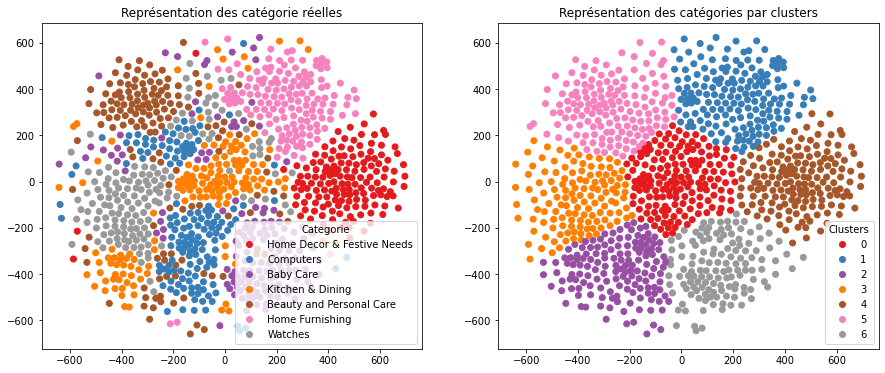

ARI :  0.4568


In [127]:
TSNE_visu_fct(X_tsne_bert[np.argmax(ARI_bert)], y_cat_num, labels_bert[np.argmax(ARI_bert)], ARI_bert[np.argmax(ARI_bert)])

**J'obtiens un ARI de 0.46, performances encore de l'ordre de grandeur des autres approches.**

## 1.7 Traitement du texte : approche Sentence Transformers

**J'importe les packages nécessaire et je crée une instance de Sentence Transformers avec le modèle pré-entrainé 'all-mpnet-base-v2'.**

In [26]:
#!pip install -U sentence-transformers --target=/kaggle/working/mysitepackages
#import sys
#sys.path.append('/kaggle/working/mysitepackages')

from sentence_transformers import SentenceTransformer

model_ST = SentenceTransformer('all-mpnet-base-v2')

**Je crée directement les features :**

In [32]:
#Our sentences we like to encode
sentences = df_data["sentence_dl"].to_list()

#Sentences are encoded by calling model.encode()
embeddings_sbert = model_ST.encode(sentences)

In [131]:
ARI_sbert = []
X_tsne_sbert = []
labels_sbert = []
perplexity = np.arange(5, 51, 2.5)

print("SBERT : ")
print("-----------------")
for perplex in perplexity:
    ARI, X_tsne, labels = ARI_fct(embeddings_sbert, perplex)
    ARI_sbert.append(ARI)
    X_tsne_sbert.append(X_tsne)
    labels_sbert.append(labels)

SBERT : 
-----------------
ARI :  0.5911 time :  2.0
ARI :  0.4847 time :  1.0
ARI :  0.5818 time :  1.0
ARI :  0.5902 time :  1.0
ARI :  0.4249 time :  1.0
ARI :  0.4127 time :  1.0
ARI :  0.3882 time :  2.0
ARI :  0.4854 time :  2.0
ARI :  0.4921 time :  1.0
ARI :  0.5939 time :  1.0
ARI :  0.5395 time :  1.0
ARI :  0.5645 time :  2.0
ARI :  0.5877 time :  2.0
ARI :  0.5291 time :  2.0
ARI :  0.599 time :  2.0
ARI :  0.5396 time :  2.0
ARI :  0.6435 time :  2.0
ARI :  0.574 time :  2.0
ARI :  0.5997 time :  2.0


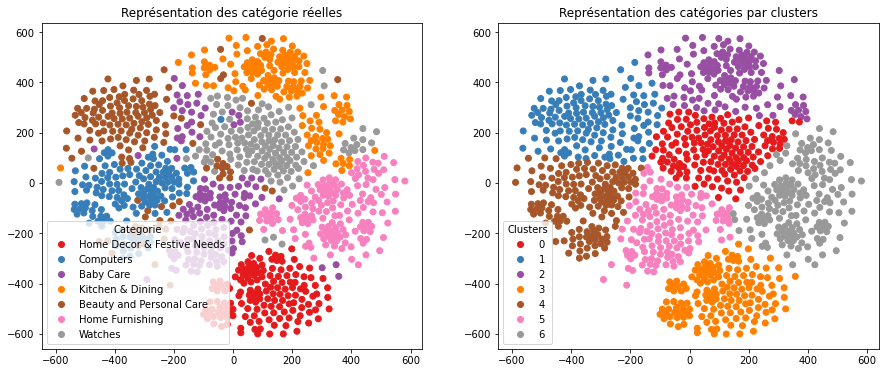

ARI :  0.6435


In [132]:
TSNE_visu_fct(X_tsne_sbert[np.argmax(ARI_sbert)], y_cat_num, labels_sbert[np.argmax(ARI_sbert)], ARI_sbert[np.argmax(ARI_sbert)])

**Les résultats obtenus sont les meilleurs de toutes les approches essayées avec un ARI = 0.64. On peut calculer l'accuracy correspondantes en réalignant les labels des clusters obtenus par k-means sur les données dont les dimensions sont réduites à 2.**

In [133]:
encoder = LabelEncoder()
encoded_Y = encoder.fit_transform(df_data["cat_1"])

cls_labels_transform = conf_mat_transform(encoded_Y, labels_sbert[np.argmax(ARI_sbert)])
conf_mat = confusion_matrix(encoded_Y, cls_labels_transform)
print(conf_mat)
print()
print(classification_report(encoded_Y, cls_labels_transform))

Correspondance des clusters :  [3 0 5 6 4 1 2]
[[103   8   0  12  21   6   0]
 [ 23 111   1  13   0   0   2]
 [  0  10 139   0   0   0   1]
 [  1   2  15 112   2  17   1]
 [ 13   7   0   1 129   0   0]
 [  2   0  13  19   1 115   0]
 [  0   0   0   0   0   0 150]]

              precision    recall  f1-score   support

           0       0.73      0.69      0.71       150
           1       0.80      0.74      0.77       150
           2       0.83      0.93      0.87       150
           3       0.71      0.75      0.73       150
           4       0.84      0.86      0.85       150
           5       0.83      0.77      0.80       150
           6       0.97      1.00      0.99       150

    accuracy                           0.82      1050
   macro avg       0.82      0.82      0.82      1050
weighted avg       0.82      0.82      0.82      1050



**Maintenant que les labels sont réalignés, on calcule une accuracy de 82 %. On pourra comparer cette valeur à l'accuracy obtenue par l'approche analyse d'image (computer vision) et par l'approche combiné NLP + CV.**

## 1.8 Traitement du texte : approche USE

In [41]:
import tensorflow_hub as hub
import re

In [55]:
tf.keras.backend.clear_session()

**En raison de problèmes d'allocation de VRAM, même sur Kaggle, je crée une instance d'un modèle USE en utilisant la RAM avec le calcul alloué sur le CPU :**  

In [47]:
with tf.device('/CPU:0'):     
    embed_use = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")
    embeddings_use = embed_use(df_data["sentence_dl"].to_list())

In [48]:
embeddings_use.shape

TensorShape([1050, 512])

In [49]:
ARI_use = []
X_tsne_use = []
labels_use = []
perplexity = np.arange(5, 51, 2.5)

print("USE : ")
print("-----------------")
for perplex in perplexity:
    ARI, X_tsne, labels = ARI_fct(np.array(embeddings_use), perplex)
    ARI_use.append(ARI)
    X_tsne_use.append(X_tsne)
    labels_use.append(labels)

USE : 
-----------------
ARI :  0.3299 time :  2.0
ARI :  0.3388 time :  2.0
ARI :  0.3554 time :  2.0
ARI :  0.3482 time :  2.0
ARI :  0.3309 time :  2.0
ARI :  0.3042 time :  2.0
ARI :  0.3783 time :  2.0
ARI :  0.4138 time :  2.0
ARI :  0.3618 time :  1.0
ARI :  0.3741 time :  2.0
ARI :  0.4025 time :  2.0
ARI :  0.3877 time :  2.0
ARI :  0.384 time :  2.0
ARI :  0.3816 time :  2.0
ARI :  0.3893 time :  2.0
ARI :  0.3821 time :  2.0
ARI :  0.3795 time :  2.0
ARI :  0.3882 time :  2.0
ARI :  0.3869 time :  2.0


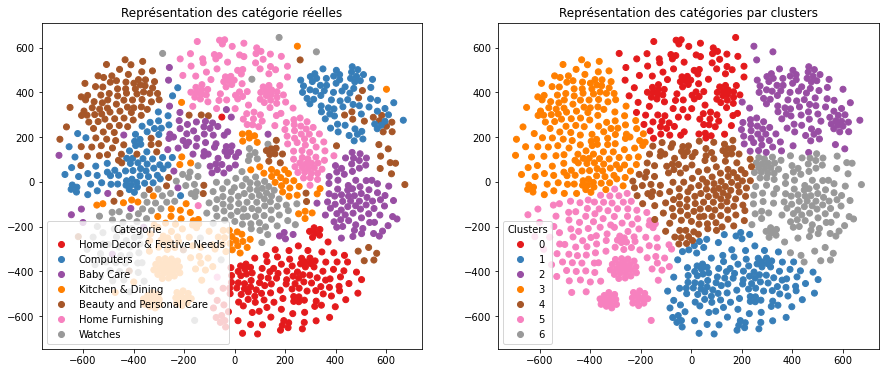

ARI :  0.4138


In [ ]:
TSNE_visu_fct(X_tsne_use[np.argmax(ARI_use)], y_cat_num, labels_use[np.argmax(ARI_use)], ARI_use[np.argmax(ARI_use)])

**Le meilleur ARI est de 0.41, de l'ordre de grandeur de toutes les approches essayées (sauf Sentence Transformers, qui est la meilleure approche)**

# 2. Partie CV

## 2.1 Traitement des images : approche SIFT

**J'importe les packages qui comprennent toutes les fonctions qui nous intéresse pour traiter les images.**

In [4]:
from IPython.display import display
from IPython.display import Image

from scipy.ndimage import gaussian_filter
from PIL import Image as Image_PIL
import cv2 as cv

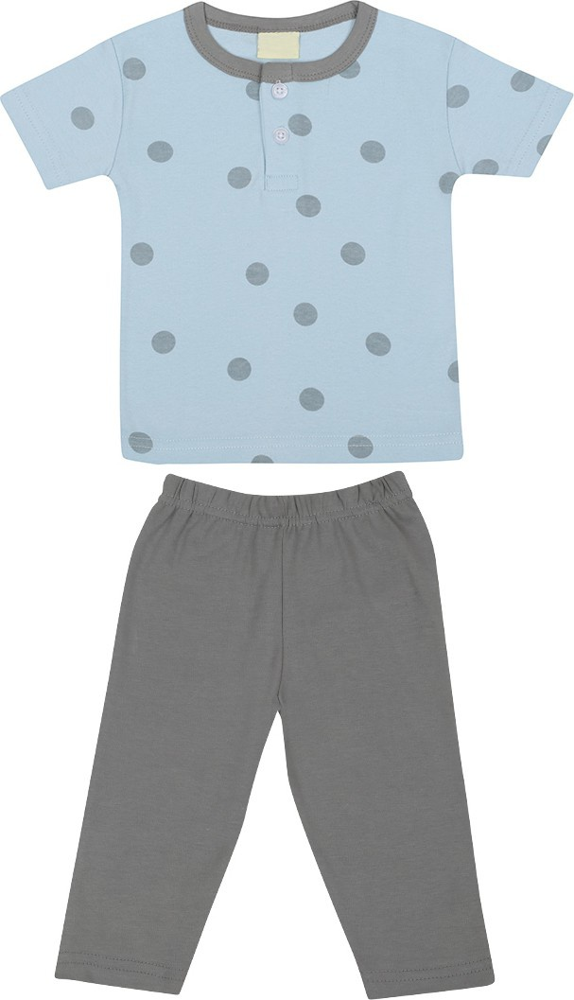

In [14]:
file = '/home/bento/P6/Data/Flipkart/Images/'+ str(df_data.iloc[42]['image'])
Image(file, width=200)

**Un exemple ci-dessus d'une image du dataset.**

**Je crée une classe image() qui va faciliter l'étude par l'approche SIFT.**

In [27]:
class image:
    def __innit__(self):
        self.img_array = 0
        
    def open_file(self, file, path):
        self.img_array = np.array(Image_PIL.open(path + "/" + file))
    
    def resize(self, width=480, height=480, DL=False):
        if DL == False:
            scale_percent = width*100/self.img_array.shape[1] # percent of reduction/zoom
            height_2 = int(self.img_array.shape[0] * scale_percent / 100)
            dim = (width, height_2)
        if DL == True:
            dim = (width, height)
        
        self.img_array_preprocessed = cv.resize(self.img_array, dim, interpolation = cv.INTER_LANCZOS4)
        
    def preprocess(self, DL=False):
        #resize
        self.resize(width=480, DL=False)
        
        #greyscale
        self.img_array_preprocessed = cv.cvtColor(self.img_array_preprocessed, cv.COLOR_BGR2GRAY)
        
        #flou gaussien
        self.img_array_preprocessed = cv.GaussianBlur(self.img_array_preprocessed, ksize=(0, 0), sigmaX=2, sigmaY=2)

        #égalisation
        self.img_array_preprocessed = cv.equalizeHist(self.img_array_preprocessed)
        
        
        
    def display_image(self, both = True):
        plt.figure(figsize=(10, 10))
        plt.imshow(self.img_array)
        plt.figure(figsize=(10, 10))
        plt.imshow(self.img_array_preprocessed, cmap='gray', vmin=0, vmax=255)
        
    def detect_sift(self):
        self.sift = cv.SIFT_create()
        self.kp, self.descriptors = self.sift.detectAndCompute(self.img_array_preprocessed, None)
        self.img_array_keypoints = cv.drawKeypoints(self.img_array_preprocessed, self.kp, self.img_array)
        
    def write_file(self, file):
        cv.imwrite(file, self.img_array_keypoints)
        
    def build_histogramme(self, kmeans):
        self.hist = np.zeros(len(kmeans.cluster_centers_))
        self.res = kmeans.predict(self.descriptors)
        self.nb_desc = self.descriptors.shape[0]
        if self.nb_desc == 0: print("Problème avec les descripteurs...")
        else:
            for i in self.res:
                self.hist[i] += 1/self.nb_desc

**La méthode preprocess permet de pré-traitement l'image en la redimensionnant, en la passant en niveaux de gris, en la floutant (pour réduire l'influence du bruit sur la détection des keypoints et descripteurs d'intérêt), et enfin en égalisant sont histogramme.** 

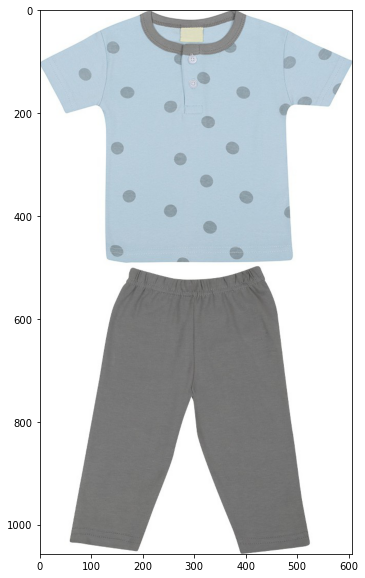

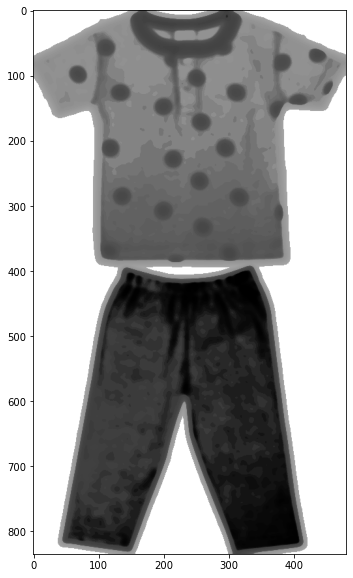

In [22]:
full_path = "/home/bento/P6/Data/Flipkart/Images"
img = image()
img.open_file(df_data.iloc[42]["image"], full_path)
img.preprocess(DL=False)
img.display_image()
img.detect_sift()
img.write_file(df_data.iloc[42]["image"])

**Je crée autant d'instance de la classe image() qu'il y a d'images dans le dataset. Pour chaque image, j'opère le pré-traitement décrit plus haut et je détecte les keypoints et les descripteurs associés.**

In [29]:
sift_desc_all = np.array((1,128))
imgs = {}
for i in range(df_data.shape[0]):
    imgs[i] = image()
    imgs[i].open_file(df_data.iloc[i]["image"], full_path)
    imgs[i].preprocess(DL=False)
    imgs[i].detect_sift()
    if i == 0:
        sift_desc_all = imgs[i].descriptors
    else:
        sift_desc_all = np.concatenate([sift_desc_all, imgs[i].descriptors], axis=0)

**J'opère un clustering k-means sur tous les descripteurs du dataset entier. Je choisis k = 741 clusters, soit la racine carrée du nombre total de descripteurs.**

In [ ]:
k = int(round(np.sqrt(sift_desc_all.shape[0])))

In [31]:
k

741

In [32]:
from cuml.cluster import KMeans as cuKMeans

kmeans = cuKMeans(
                n_clusters=k,
                random_state=42,
                oversampling_factor=40,
                init="k-means++"
)
kmeans.fit(sift_desc_all)

KMeans()

**Pour chaque image, je construis l'histogramme des clusters, i.e. le nombre de descripteurs de l'image appartenant à chacun des 741 clusters définis plus haut. Le profil/histogramme obtenu est normalisé et il est caractéristique d'une image.** 

In [33]:
full_path = "/home/bento/P6/Data/Flipkart/Images"
for i in range(df_data.shape[0]):
    imgs[i].build_histogramme(kmeans)

In [34]:
imgs_hist_all = np.zeros((df_data.shape[0], imgs[0].hist.shape[0]))
for i in range(len(imgs)):
    imgs_hist_all[i] = imgs[i].hist.reshape(1,-1)
imgs_hist_all.shape

(1050, 741)

**Je définis des fonctions qui permettent de faire d'opérer une réduction de dimension via PCA.**

In [35]:
from sklearn.decomposition import PCA

# Définition d'une fonction qui affiche les cercles de corrélations
def display_circles(
    pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None
):
    for (
        d1,
        d2,
    ) in (
        axis_ranks
    ):  # On affiche les 3 premiers plans factoriels
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(10, 10))

            # détermination des limites du graphique
            if lims is not None:
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30:
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else:
                xmin, xmax, ymin, ymax = (
                    min(pcs[d1, :]),
                    max(pcs[d1, :]),
                    min(pcs[d2, :]),
                    max(pcs[d2, :]),
                )

            # affichage des flèches
            if pcs.shape[1] < 30:
                plt.quiver(
                    np.zeros(pcs.shape[1]),
                    np.zeros(pcs.shape[1]),
                    pcs[d1, :],
                    pcs[d2, :],
                    angles="xy",
                    scale_units="xy",
                    scale=1,
                    color="grey",
                )

            else:
                lines = [[[0, 0], [x, y]] for x, y in pcs[[d1, d2]].T]
                ax.add_collection(
                    LineCollection(lines, axes=ax, alpha=0.1, color="black")
                )

            # affichage des noms des variables
            if labels is not None:
                for i, (x, y) in enumerate(pcs[[d1, d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax:
                        plt.text(
                            x,
                            y,
                            labels[i],
                            fontsize="14",
                            ha="center",
                            va="center",
                            rotation=label_rotation,
                            color="blue",
                            alpha=0.5,
                        )

            # affichage du cercle
            circle = plt.Circle((0, 0), 1, facecolor="none", edgecolor="b")
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)

            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color="grey", ls="--")
            plt.plot([0, 0], [-1, 1], color="grey", ls="--")

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel(
                "F{} ({}%)".format(
                    d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)
                )
            )
            plt.ylabel(
                "F{} ({}%)".format(
                    d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)
                )
            )

            plt.title(
                "Cercle des corrélations (F{} et F{})".format(d1 + 1, d2 + 1)
            )
            plt.show(block=False)


# Définition d'une fonction qui affiche la projection des individus
def display_factorial_planes(
    X_projected,
    n_comp,
    pca,
    axis_ranks,
    labels=None,
    alpha=1,
    illustrative_var=None,
):
    colors = [
        "red",
        "green",
        "blue",
        "yellow",
        "pink",
        "black",
        "orange",
        "purple",
        "beige",
        "brown",
        "gray",
        "cyan",
        "magenta",
    ]
    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            # initialisation de la figure
            fig = plt.figure(figsize=(15, 15))

            # affichage des points
            if illustrative_var is None:
                plt.scatter(
                    X_projected[:, d1], X_projected[:, d2], alpha=alpha
                )
            else:
                illustrative_var = np.array(illustrative_var)
                for i, value in enumerate(np.unique(illustrative_var)):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(
                        X_projected[selected, d1],
                        X_projected[selected, d2],
                        alpha=alpha,
                        marker="o",
                        c=colors[i],
                    )  # , label=value)
                plt.legend(np.unique(illustrative_var), fontsize="small")

            # affichage des labels des points
            if labels is not None:
                for i, (x, y) in enumerate(X_projected[:, [d1, d2]]):
                    plt.text(
                        x,
                        y,
                        labels[i],
                        fontsize="14",
                        ha="center",
                        va="center",
                    )

            # détermination des limites du graphique
            boundary = np.max(np.abs(X_projected[:, [d1, d2]])) * 1.1
            plt.xlim([-boundary, boundary])
            plt.ylim([-boundary, boundary])

            # affichage des lignes horizontales et verticales
            plt.plot([-100, 100], [0, 0], color="grey", ls="--")
            plt.plot([0, 0], [-100, 100], color="grey", ls="--")

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel(
                "F{} ({}%)".format(
                    d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)
                )
            )
            plt.ylabel(
                "F{} ({}%)".format(
                    d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)
                )
            )

            plt.title(
                "Projection des individus (sur F{} et F{})".format(
                    d1 + 1, d2 + 1
                )
            )
            plt.show(block=False)


# Définition d'une fonction qui affiche l'ébouli
def display_scree_plot(pca):
    scree = pca.explained_variance_ratio_ * 100
    plt.bar(np.arange(len(scree)) + 1, scree)
    plt.plot(np.arange(len(scree)) + 1, scree.cumsum(), c="red", marker="o")
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.show(block=False)

PCA(n_components=741)

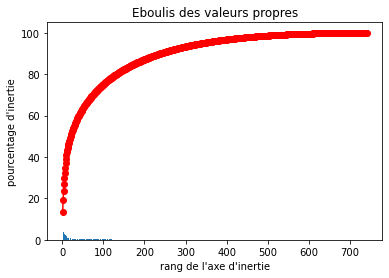

In [36]:
n_comp = imgs_hist_all.shape[1]

pca = PCA(n_components=n_comp)
pca.fit(imgs_hist_all)

# Eboulis des valeurs propres
display_scree_plot(pca)
plt.show()

**D'après le graph des éboulis des valeurs propres, on peut réduire les dimensions à 540 tout en gardant 99% de la variance des data.**

In [37]:
np.cumsum(pca.explained_variance_ratio_)[540]
X_pca = pca.transform(imgs_hist_all)[:, :541]

0.9909006174053576

In [38]:
from yellowbrick.cluster import kelbow_visualizer
from sklearn.cluster import KMeans as skKMeans
from cuml.cluster import KMeans as cuKMeans
from cuml.manifold import TSNE as cuTSNE
from sklearn.manifold import TSNE as skTSNE
from sklearn.metrics import silhouette_score
from cuml.metrics.cluster.silhouette_score import (
    cython_silhouette_score,
    cython_silhouette_samples,
)
import matplotlib.cm as cm

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif


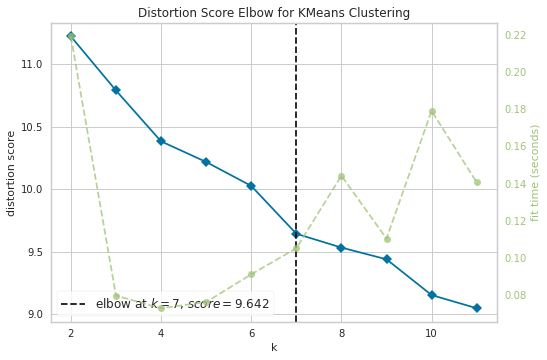

In [39]:
model = skKMeans()
visualizer = kelbow_visualizer(model, X_pca, k=(2, 12))

**La méthode du coude prévoit k = 7 clusters comme nombre optimal.**

In [71]:
ARI_sift = []
X_tsne_sift = []
labels_sift = []
perplexity = np.arange(5, 51, 5)
print("SIFT : ")
print("--------")
for k, perplex in enumerate(perplexity):
    ARI, X_tsne, labels = ARI_fct(X_pca, perplex)
    ARI_sift.append(ARI)
    X_tsne_sift.append(X_tsne)
    labels_sift.append(labels)

SIFT : 
--------
ARI :  0.0352 time :  3.0
ARI :  0.0378 time :  2.0
ARI :  0.038 time :  2.0
ARI :  0.0347 time :  2.0
ARI :  0.0276 time :  2.0
ARI :  0.0398 time :  2.0
ARI :  0.0345 time :  2.0
ARI :  0.0358 time :  2.0
ARI :  0.0392 time :  2.0
ARI :  0.0315 time :  2.0


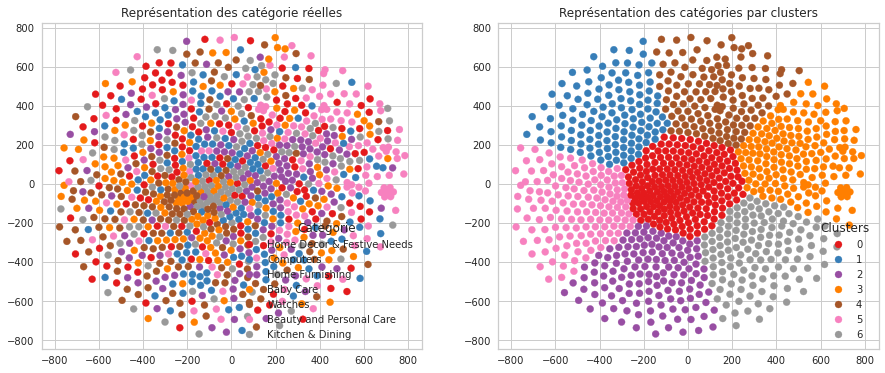

ARI :  0.0398


In [72]:
j = np.argmax(ARI_sift)
TSNE_visu_fct(X_tsne_sift[j], y_cat_num, labels_sift[j], ARI_sift[j])

**Les résultats du clustering des histogrammes de toutes les images sont très décevant. Comme l'atteste le graph ci-dessus à gauche, on ne constante pas particulièrement de ségrégation des catégories. L'ARI obtenu est de 0.04**

## 2.2 Traitement des images : approche CNN

**J'importe les packages spécifique aux CNN. J'ai choisi d'utiliser une architecture EfficientNetV2L (state-of-the-art).**

In [74]:
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2L
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input

**Je crée une couche d'input aux dimensions requises par EfficientNetV2L puis je crée une instance du modèle sans la dernière couche de softmax. Un pooling average me permet de récupérer les features des dernières couches de convolution sous la forme d'un tenseur 1D de taille (,1280). Les poids pré-entrainé sur le dataset 'imagenet' sont chargés en mémoire.** 

In [82]:
tf.keras.backend.clear_session()
input_layer = Input(shape=(480, 480, 3),dtype='float64')
Effnetv2L = tf.keras.applications.efficientnet_v2.EfficientNetV2L(
    include_top=False,
    weights='imagenet',
    input_tensor=input_layer,
    input_shape=(480, 480, 3),
    pooling='avg',
    include_preprocessing=True
)

**Je crée une boucle qui récupère toutes les features de chaque image de notre dataset détectées par le modèle EfficientNetV2L.**

In [88]:
full_path = "/home/bento/P6/Data/Flipkart/Images"
features_CNN = np.zeros((1, 1280))

for i in range(df_data.shape[0]):
    img_path = full_path + "/" + df_data.iloc[i]["image"]
    img = image.load_img(img_path, target_size=(480, 480))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    if i == 0:
        features_CNN = Effnetv2L.predict(x)
    else:
        features_CNN = np.concatenate([features_CNN, Effnetv2L.predict(x)], axis=0)

1/1 [==============================] - 0s 44ms/step


/home/bento/miniconda3/envs/rapids-21.12/lib/python3.7/site-packages/PIL/Image.py:3038: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


1/1 [==============================] - 0s 108ms/step


In [89]:
features_CNN.shape

(1050, 1280)

**Les dimensions du tenseur de features sont bien de (1050, 1280), comme attendu.**

PCA(n_components=1050)

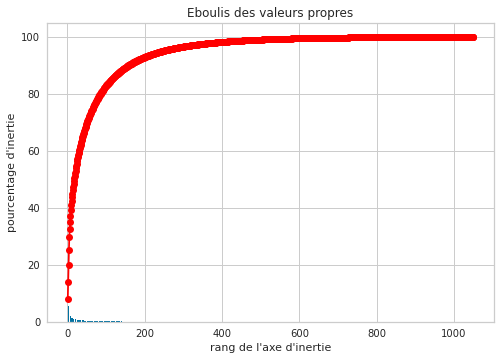

In [90]:
n_comp = min(features_CNN.shape[0], features_CNN.shape[1])

pca = PCA(n_components=n_comp)
pca.fit(features_CNN)

# Eboulis des valeurs propres
display_scree_plot(pca)
plt.show()

In [91]:
np.cumsum(pca.explained_variance_ratio_)[600]
X_pca_CNN_feat = pca.transform(features_CNN)[:, :601]

0.9956329

**L'éboulis des valeurs propres indique qu'on peut sélectionner les 600 premières composantes tout en gardant 99.5 % de la variance des datas.**

In [94]:
ARI_CNN = []
X_tsne_CNN = []
labels_CNN = []
perplexity = np.arange(5, 51, 5)
print("CNN : ")
print("--------")
for k, perplex in enumerate(perplexity):
    ARI, X_tsne, labels = ARI_fct(X_pca_CNN_feat, perplex)
    ARI_CNN.append(ARI)
    X_tsne_CNN.append(X_tsne)
    labels_CNN.append(labels)

CNN : 
--------
ARI :  0.4834 time :  2.0
ARI :  0.5061 time :  2.0
ARI :  0.548 time :  2.0
ARI :  0.5616 time :  2.0
ARI :  0.5614 time :  2.0
ARI :  0.5719 time :  2.0
ARI :  0.594 time :  2.0
ARI :  0.5568 time :  2.0
ARI :  0.5368 time :  2.0
ARI :  0.49 time :  2.0


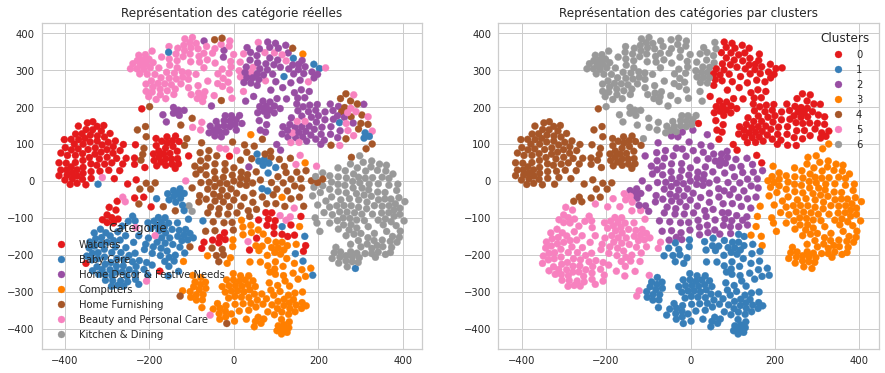

ARI :  0.5944


In [201]:
j = np.argmax(ARI_CNN)
TSNE_visu_fct(X_tsne_CNN[j], y_cat_num, labels_CNN[j], ARI_CNN[j])

**Le meilleur ARI obtenu est de 0.59, presque aussi bien que l'ARI obtenu pour Sentence Transformers (0.64) dans la partie NLP ! Voyons maintenant, si en combinant les features NLP et CV, on peut obtenir de meilleurs résultats :**

# 3. Partie features combinée : NLP + CV

In [33]:
embeddings_sbert.shape

(1050, 768)

**Les dimensions des features NLP de Sentence Transformers sont (,768) et les dimensions des features CNN sont (,1280). Je choisis d'utiliser les 600 premières composantes principales des features CNN afin d'avoir à peu près le même nombre de feature NLP et CNN.**

PCA(n_components=768)

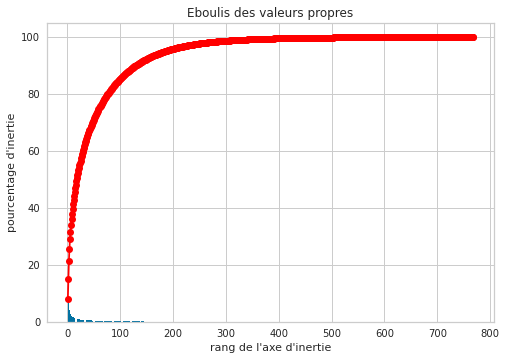

In [106]:
n_comp = min(embeddings_sbert.shape[0], embeddings_sbert.shape[1])

pca = PCA(n_components=n_comp)
pca.fit(embeddings_sbert)

# Eboulis des valeurs propres
display_scree_plot(pca)
plt.show()

In [107]:
np.cumsum(pca.explained_variance_ratio_)[400]
X_pca_sbert = pca.transform(embeddings_sbert)[:, :401]

0.99540013

**Je concatène simplement les features NLP et CNN (réduite par PCA).**

In [122]:
combined_feat = np.concatenate([embeddings_sbert, X_pca_CNN_feat], axis=1)

In [123]:
combined_feat.shape

(1050, 1369)

In [99]:
ARI_combined = []
X_tsne_combined = []
labels_combined = []
perplexity = np.arange(5, 51, 5)
print("combined : ")
print("--------")
for k, perplex in enumerate(perplexity):
    print("index : ", k)
    ARI, X_tsne, labels = ARI_fct(combined_feat, perplex)
    ARI_combined.append(ARI)
    X_tsne_combined.append(X_tsne)
    labels_combined.append(labels)

combined : 
--------
index :  0
ARI :  0.4688 time :  2.0
index :  1
ARI :  0.5041 time :  2.0
index :  2
ARI :  0.5156 time :  2.0
index :  3
ARI :  0.541 time :  2.0
index :  4
ARI :  0.5875 time :  2.0
index :  5
ARI :  0.5793 time :  2.0
index :  6
ARI :  0.5629 time :  2.0
index :  7
ARI :  0.5115 time :  2.0
index :  8
ARI :  0.5334 time :  2.0
index :  9
ARI :  0.529 time :  2.0


**Un simple clustering des features concaténées ne donne pas de résultat satisfaisant (moins bon que NLP tout seul qui avait pour ARI 0.64 et une accuracy correspondante de 82 %)**

**Je décide donc de passer par une approche supervisée consistant à traiter les features concaténées dans un simple réseaux de neurones ainsi constitué : input layer -> Dense (reLU) -> Dropout (0.5) -> Dense (reLU) -> Dropout (1/3) -> output layer (softmax 7)** 

In [136]:
def baseline_model():
    input_layer_combined = Input(shape=(combined_feat.shape[1],), dtype='float64')
    #x = Dense(combined_feat.shape[1], activation="relu")(input_layer_combined)
    #x = Dropout(0.66)(x)
    #x = Dense(int(round(combined_feat.shape[1]/2)), activation="relu")(input_layer_combined)
    #x = Dropout(0.5)(x)
    #x = Dense(int(round(combined_feat.shape[1]/4)), activation="relu")(x)
    #x = Dropout(0.5)(x)
    #x = Dense(int(round(combined_feat.shape[1]/8)), activation="relu")(x)
    #x = Dropout(0.5)(x)
    x = Dense(int(round(combined_feat.shape[1]/16)), activation="relu")(input_layer_combined)
    x = Dropout(0.5)(x)
    x = Dense(int(round(np.sqrt(combined_feat.shape[1]))), activation="relu")(x)
    x = Dropout(1/3)(x)
    x = Dense(7, activation="softmax")(x)

    model_combined = Model(input_layer_combined, x)
    model_combined.compile(loss="categorical_crossentropy", optimizer="adam", metrics=['accuracy'])
    
    return model_combined

**Je crée une instance du modèle custom avec des valeurs standards pour le nombre d'epoch et le batch_size.**

In [137]:
from scikeras.wrappers import KerasClassifier

tf.keras.backend.clear_session()
estimator = KerasClassifier(model=baseline_model, epochs=500, batch_size=128, verbose=0)

In [138]:
from keras.utils import np_utils
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import LabelEncoder

Y = df_data["cat_1"]
X = combined_feat
# encode class values as integers
encoder = LabelEncoder()
encoder.fit(Y)
encoded_Y = encoder.transform(Y)
# convert integers to dummy variables (i.e. one hot encoded)
#dummy_y = np_utils.to_categorical(encoded_Y)

LabelEncoder()

**Je split les données en train et test sets de manière stratifiée avec une 100 individus train, pour chaque catégorie d'article, et 50 individus test.**

**J'opère ensuite une évaluation du modèle par crossvalidation (5 splits)**

In [139]:
indices = np.arange(X.shape[0])
X_train, X_test, y_train, y_test, indices_train, indices_test = train_test_split(X, encoded_Y, indices, test_size=1/3, random_state=42, stratify=encoded_Y)
skf = StratifiedKFold(n_splits=5, shuffle=False)
scores = []

for train_ix, valid_ix in skf.split(X_train, y_train):
    train_X, valid_X = X_train[train_ix], X_train[valid_ix]
    train_y, valid_y = y_train[train_ix], y_train[valid_ix]
    dummy_train_y = np_utils.to_categorical(train_y)
    dummy_valid_y = np_utils.to_categorical(valid_y)
    estimator.fit(train_X, dummy_train_y)
    scores.append(estimator.score(valid_X, dummy_valid_y))

results = scores
print("Crossvalidation accuracy: %.2f%% (%.2f%%)" % (np.mean(results)*100, np.std(results)*100))

KerasClassifier(
	model=<function baseline_model at 0x7f37696d1440>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=rmsprop
	loss=None
	metrics=None
	batch_size=128
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=500
	class_weight=None
)

KerasClassifier(
	model=<function baseline_model at 0x7f37696d1440>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=rmsprop
	loss=None
	metrics=None
	batch_size=128
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=500
	class_weight=None
)

KerasClassifier(
	model=<function baseline_model at 0x7f37696d1440>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=rmsprop
	loss=None
	metrics=None
	batch_size=128
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=500
	class_weight=None
)

KerasClassifier(
	model=<function baseline_model at 0x7f37696d1440>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=rmsprop
	loss=None
	metrics=None
	batch_size=128
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=500
	class_weight=None
)

KerasClassifier(
	model=<function baseline_model at 0x7f37696d1440>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=rmsprop
	loss=None
	metrics=None
	batch_size=128
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=500
	class_weight=None
)

Crossvalidation accuracy: 92.00% (3.48%)


**La crossvalidation donne un score d'accuracy de 92 %, ce qui est mieux que le meilleur score obtenu dans la partie NLP seul (82 %).**

In [140]:
dummy_test_y = np_utils.to_categorical(y_test)
dummy_train_y = np_utils.to_categorical(y_train)
estimator.fit(X_train, dummy_train_y)
estimator.score(X_test, dummy_test_y)

KerasClassifier(
	model=<function baseline_model at 0x7f37696d1440>
	build_fn=None
	warm_start=False
	random_state=None
	optimizer=rmsprop
	loss=None
	metrics=None
	batch_size=128
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=500
	class_weight=None
)

0.9485714285714286

**Le test score donne une accuracy de 95 % ! Cela confirme qu'une approche hybride NLP + CNN fonctionne mieux qu'une approche NLP ou CV seule.**

In [237]:
scores

[0.9071428571428571,
 0.9214285714285714,
 0.9214285714285714,
 0.8857142857142857,
 0.9785714285714285]

In [78]:
X_test.shape

(350, 1369)

In [102]:
int(round(np.sqrt(combined_feat.shape[1])))

37

In [185]:
predictions = np.round(estimator.predict(X_test))
wrong_predictions_test = (predictions != dummy_test_y)

"Key Features of HomeEdge Solid Wood King Bed King Bed 72x78 Mattress Size 1 King Bed Natural Polish,HomeEdge Solid Wood King Bed (Finish Color -  Natural) Price: Rs. 18,799 Made to Order SolidWood Bed made by the finest artisans from Rajasthan. Bed is made to perfection. These Beds are handicraft products which are made to order by the manufacturer. Please make sure that this bed is ordered once you are aware of the entire product. Mattress Dimension of a Queen Size Bed will be 60inch x 78inch and Mattress Dimension of a King Bed will be 72inch x 78inch. Kindly check the mattress size before you order the bed. Also, the polish might have a slight variation as these are wooden products and grains are not uniform. due to grains the polish might look light or dark in some portions. All the Wooden products are termite treated and has gone through a high level quality check before being packed.,Specifications of HomeEdge Solid Wood King Bed (Finish Color -  Natural) Installation & Demo Ins

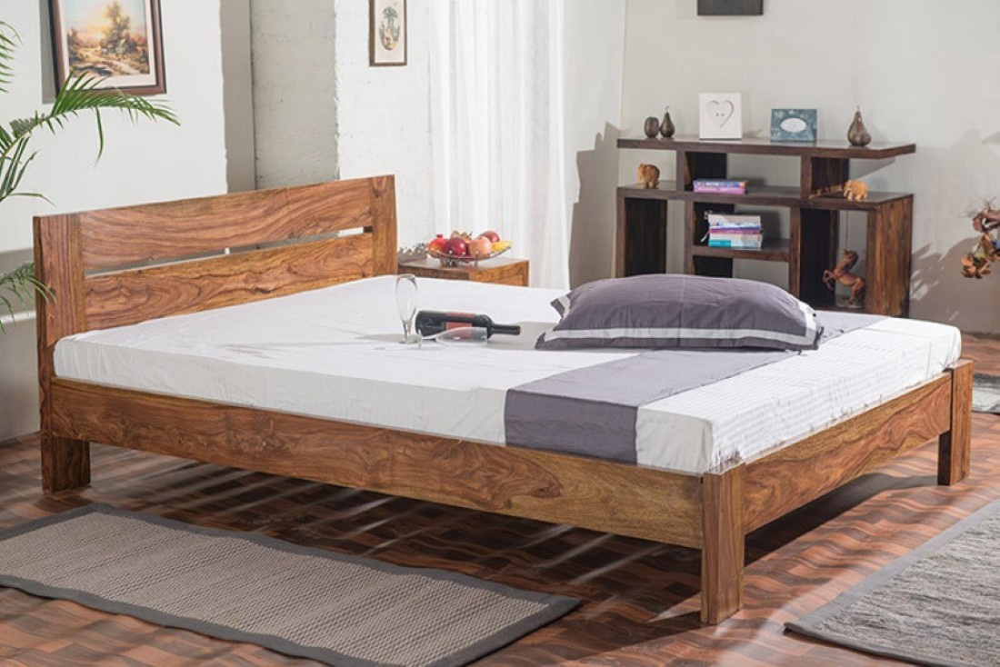

'Myesquire Ceramic Burner Pot Lemongrass Liquid Air Freshener (30 ml)\r\n                         Price: Rs. 245\r\n\t\t\t\t\r\n\t\t\tIlluminate Every Corner Of Your Living Room In Style With This Home Fragrance Electric Burner Combo With Fragrance That Is Brought To You By Myesquire. This Is A Very Unique, Useful And Value for Money Product For Home Decoration And Fragrance. This Unique Combo Contains Aroma Burner With All Accessories and is ready to use . Put A Small Amount 1-2 Tea Spoon Of Aroma Oil On The Bowl Surface And Light The Tea Light and After Few Minutes As The Oil Heats Up, The Fragrance Will Spread In The Room. And You Will Be All Set To Enjoy The Captivating Aroma. Keep It Away From Children As Surface Becomes Hot.\r\nIlluminate Every Corner Of Your Living Room In Style With This Home Fragrance Electric Burner Combo With Fragrance That Is Brought To You By Myesquire. This Is A Very Unique, Useful And Value for Money Product For Home Decoration And Fragrance. This Unique

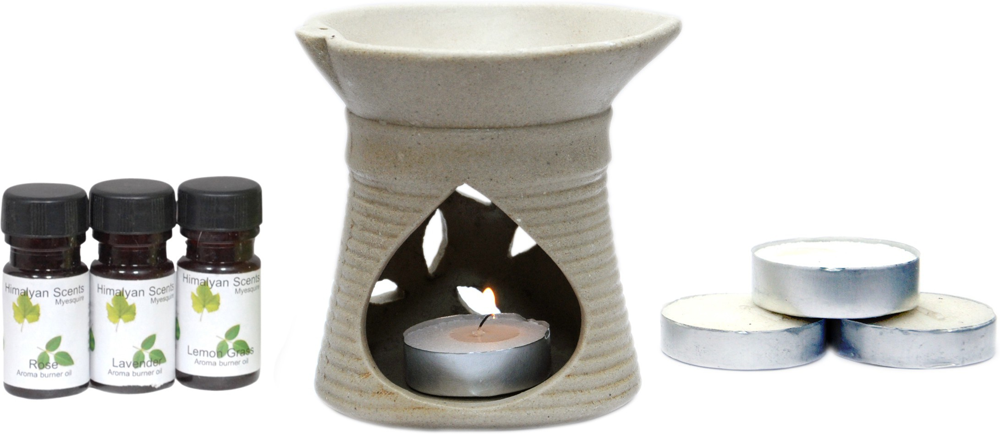

"Specifications of Oxolloxo Solid Single Breasted Casual Women's Blazer General Details Pattern Solid Ideal For Women's Occasion Casual Blazer Details Sleeve Sleeveless Number of Contents in Sales Package Pack of 1 Fabric Linen Type Single Breasted Color Orange Fabric Care Machine wash, do not bleach, do not tumble dry, warm iron, dry cleanable. Additional Details Style Code S16184WBZ006"

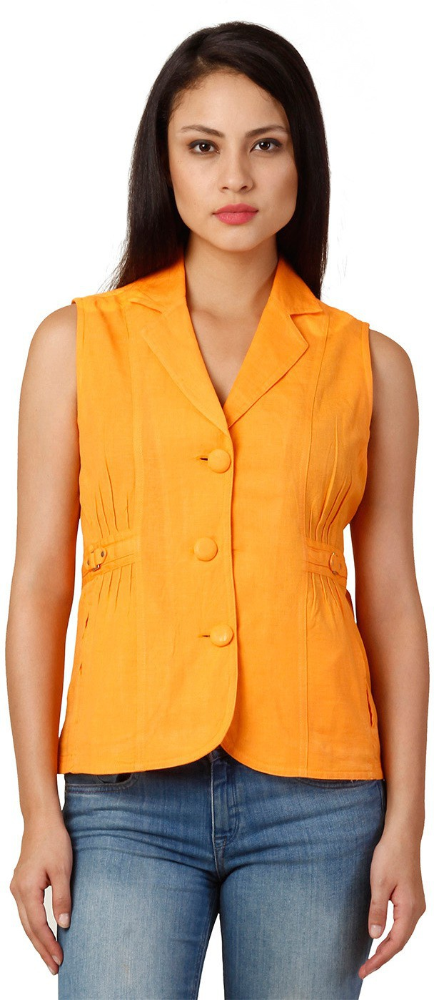

'Buy Baby Bucket Cartoon Single Blanket blue at Rs. 1395 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery!'

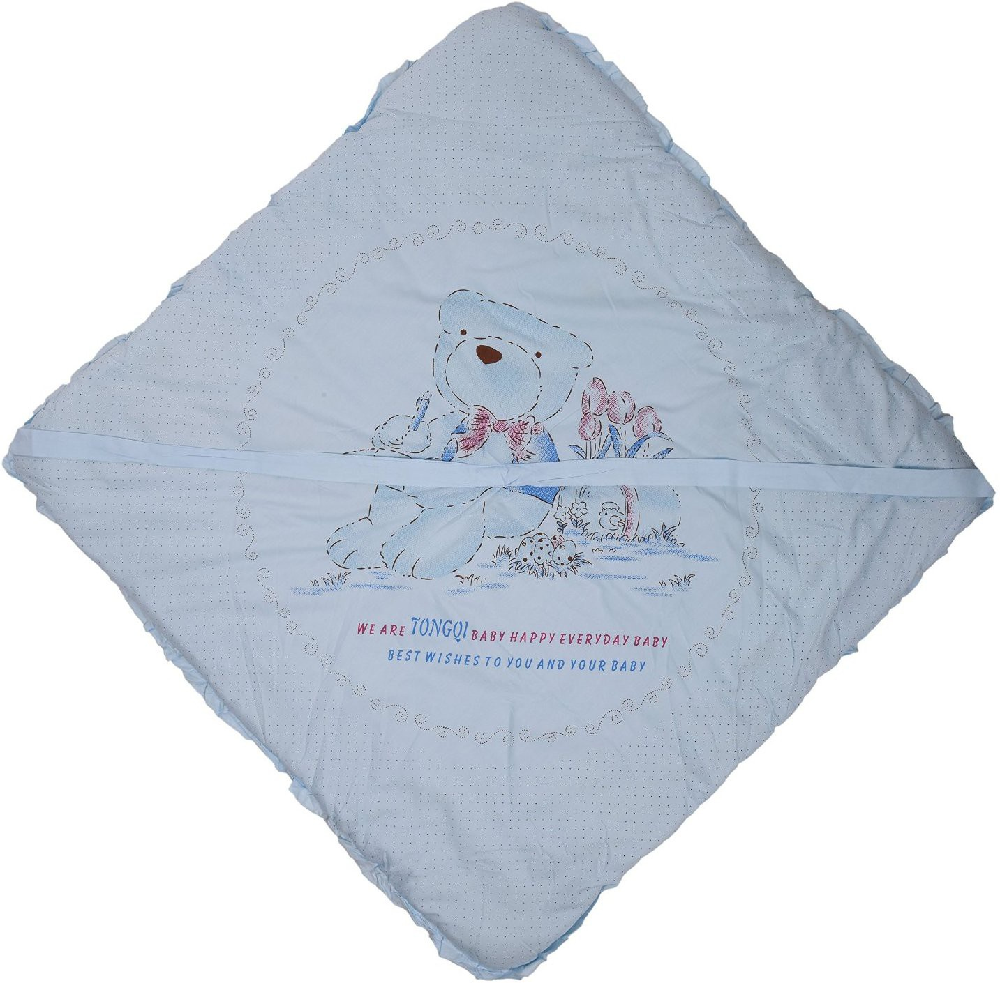

'Specifications of Sivanna Baking Powder Rouge  Highlighter (Dark pink brown shimmer 10) General Traits Organic Type Mineral Quantity 12 Shade Dark pink brown shimmer 10 Ideal For Girls, Women Container Type Compact Case Highlighter Traits Multi-shaded Yes Texture Powder based In the Box Highlighter'

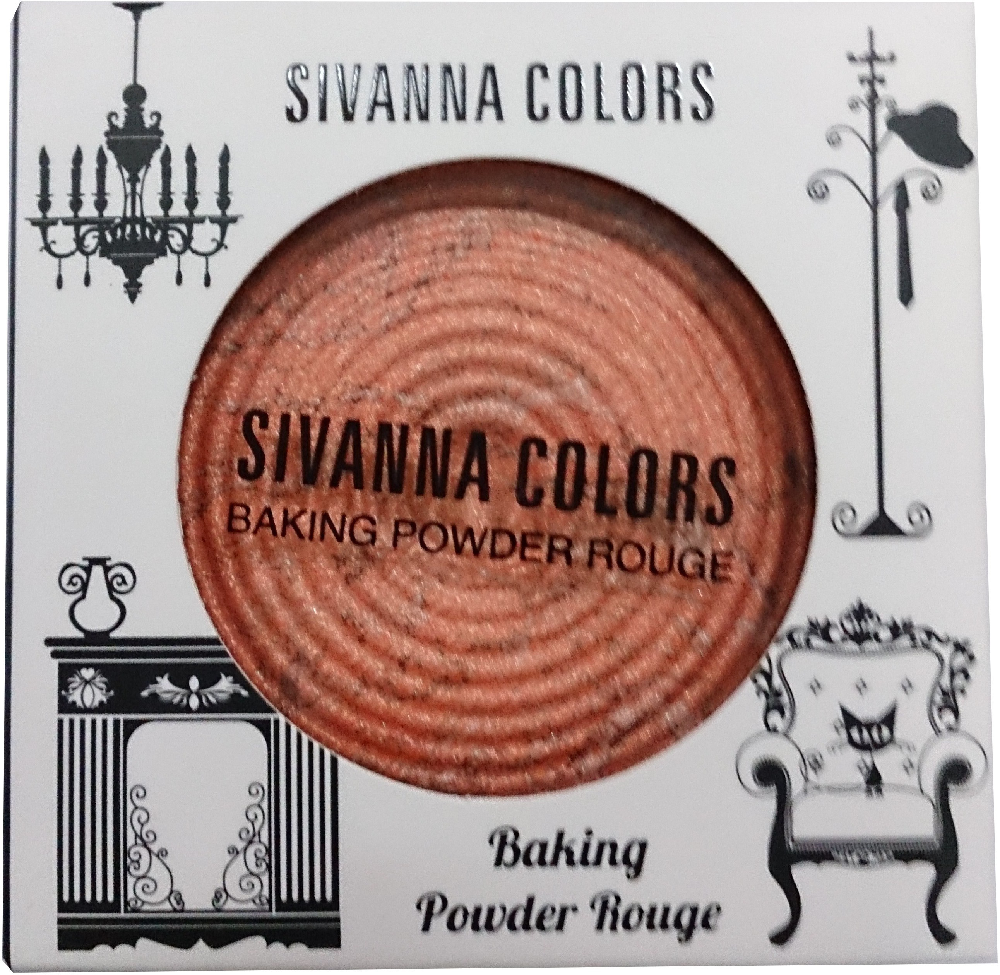

'Buy Borse N16 Make Up And Jewellery Vanity Case for Rs.680 online. Borse N16 Make Up And Jewellery Vanity Case at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.'

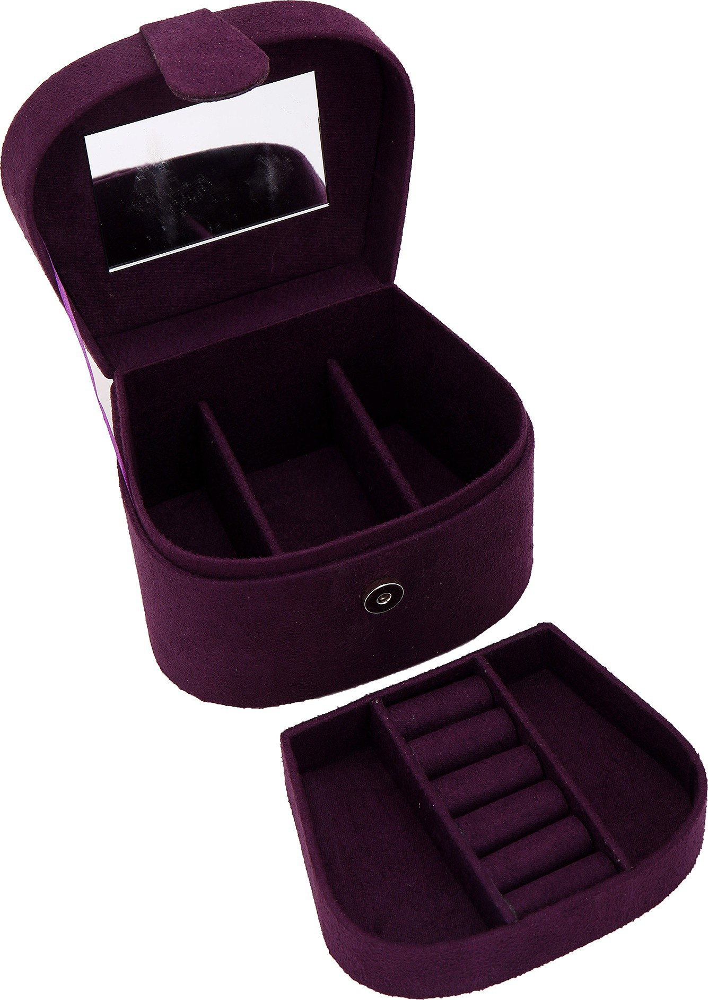

'Just Linen Cotton Bath Towel (2 Terry Bath Towels, Lilac and Orange)\r\n                         Price: Rs. 1,052\r\n\t\t\t\t\r\n\t\t\tPlain and Simple does the trick! This Classic Super Soft and Very Heavy Bath Towel has terry loop threads all over with thick ribbed horizontal lines on either end. This towel has a short loop and is therefore very absorbent and quick drying. Ideal for daily home usage for Kids. These towels are a perfect addition to your exclusive Kids Bath Linen Collection.\r\nPlain and Simple does the trick! This Classic Super Soft and Very Heavy Bath Towel has terry loop threads all over with thick ribbed horizontal lines on either end. This towel has a short loop and is therefore very absorbent and quick drying. Ideal for daily home usage for Kids. These towels are a perfect addition to your exclusive Kids Bath Linen Collection.'

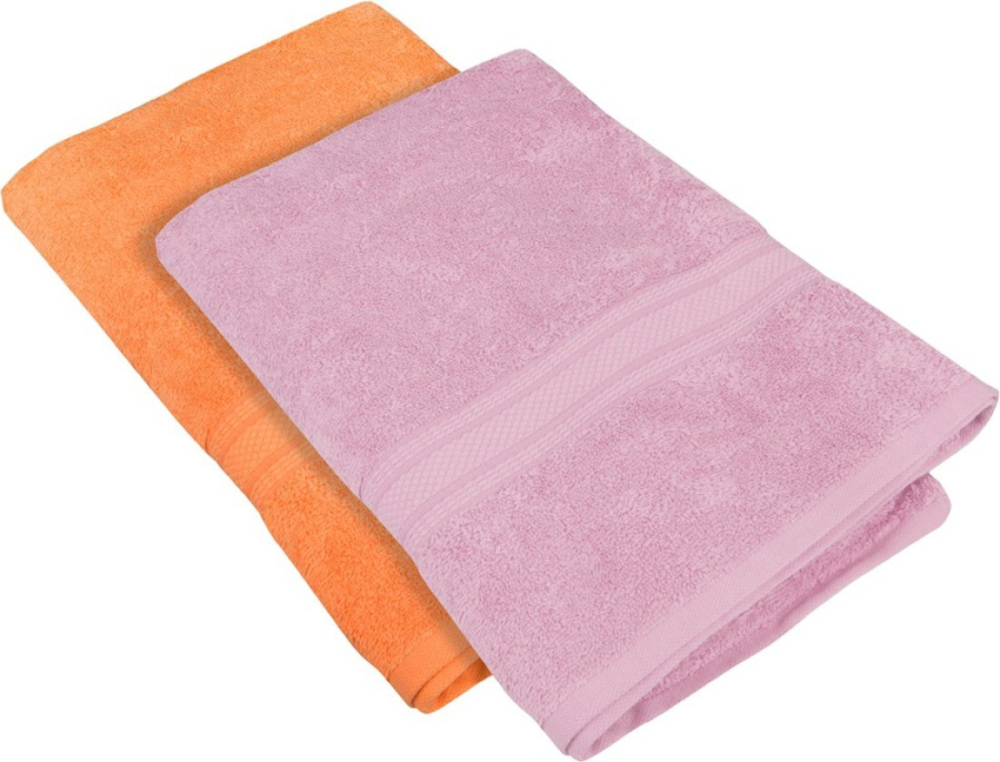

'Specifications of GAYATRI CREATIONS ORANGE KIDS SET 2 Containers Lunch Box (400 ml) General Series BEST OF LUCK Model Name ORANGE KIDS SET Lunch Box Features Lunch Box Material Plastic Number of Containers 2 Lunch Box Capacity 400 ml In the Box 1 LUNCH BOX, 1 WATER BOTTLE'

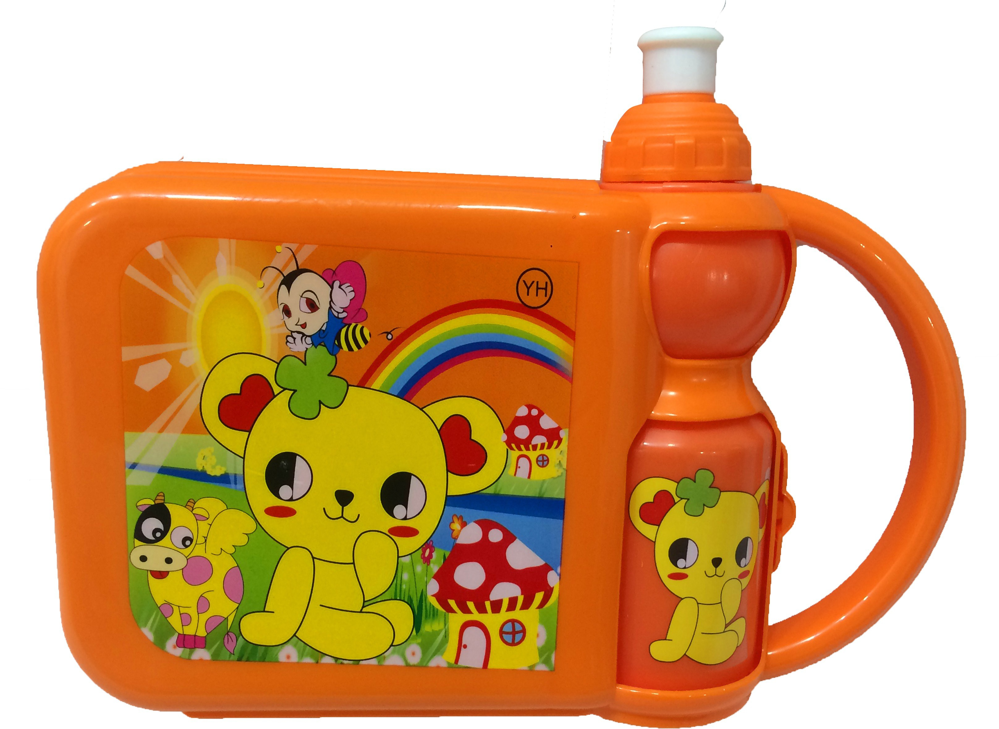

'Buy Elite Collection Medium Acrylic Sticker for Rs.999 online. Elite Collection Medium Acrylic Sticker at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.'

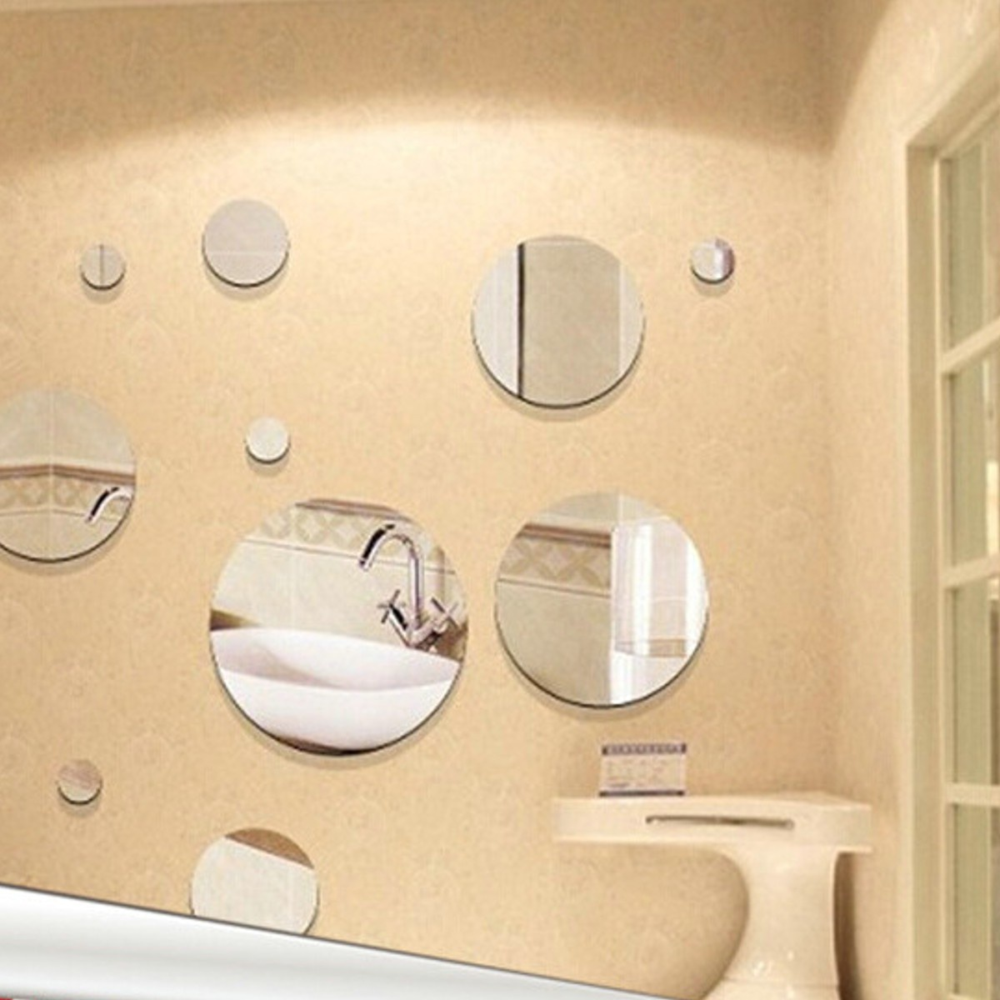

'Buy Ireeya Abstract Single Coral Blanket Blue at Rs. 529 at Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery!'

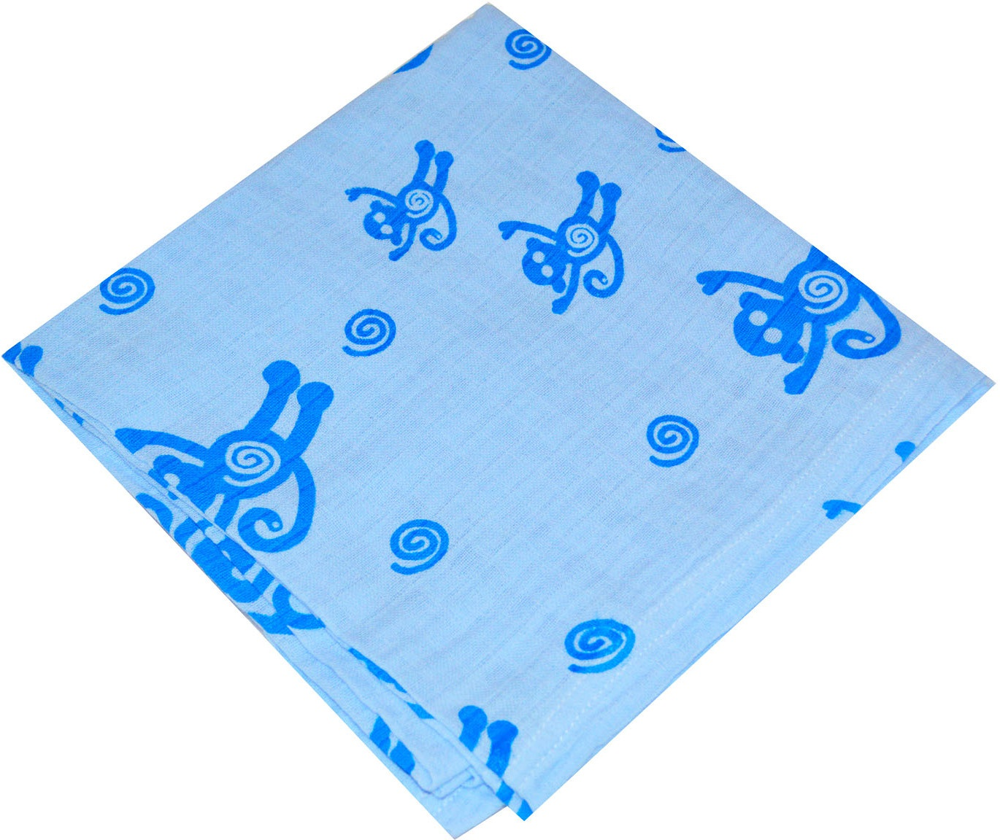

'Key Features of Sparklings Cotton Checkered Double Bedsheet Best Fit For:-Large Size Double Bed(6.5 ft X 6 ft) Thread Count:160 TC Package Content:1 Double Bedsheet With 2 Pillow Cover,Sparklings Cotton Checkered Double Bedsheet (double bedsheet with pillow covers, Multicolor) Price: Rs. 549 There are days when you don’t want to socialise, and just curl up on your bed, and read, or watch your favourite TV show. For those days, you can jazz up your bedroom décor, by spreading this double bedsheet from SPARKLINGS to pep up your mood. Print that you will Love The blend of abstract and floral prints gives this bedsheet an appealing look. Cotton You wouldn’t want to leave your bedroom anymore, as the bedsheet and two pillow covers are made of cotton to help you relax your body and mind as soon as you hit the bed.,Specifications of Sparklings Cotton Checkered Double Bedsheet (double bedsheet with pillow covers, Multicolor) General Brand Sparklings Machine Washable Yes Type Flat Material Cot

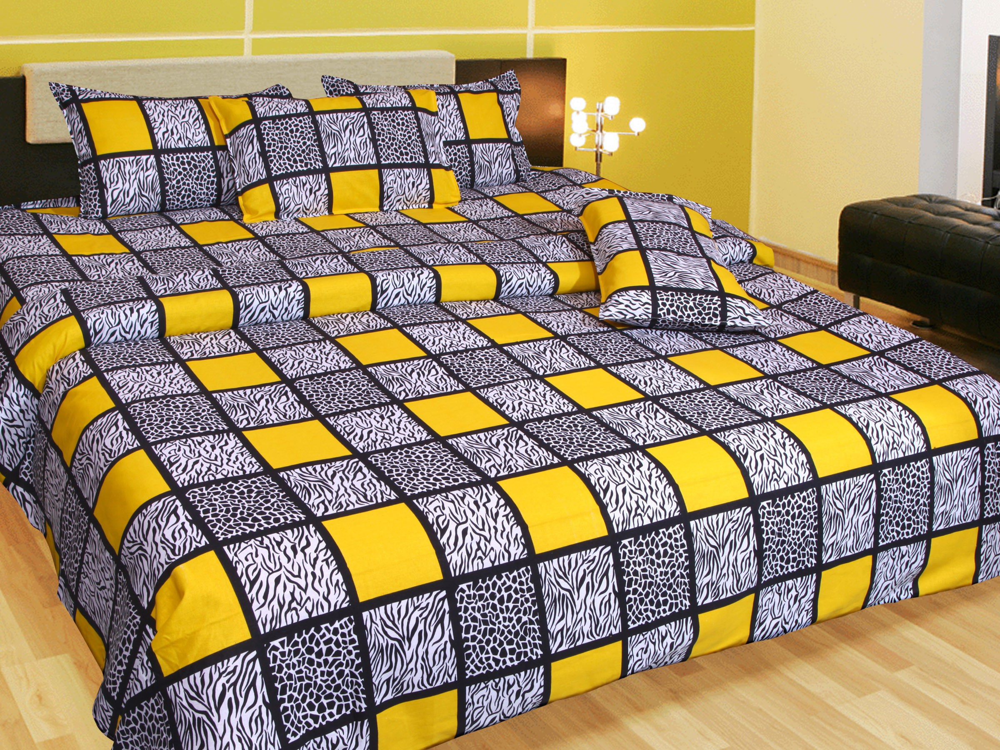

'Buy Wallmantra Medium Vinyl Stickers Sticker for Rs.1143 online. Wallmantra Medium Vinyl Stickers Sticker at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.'

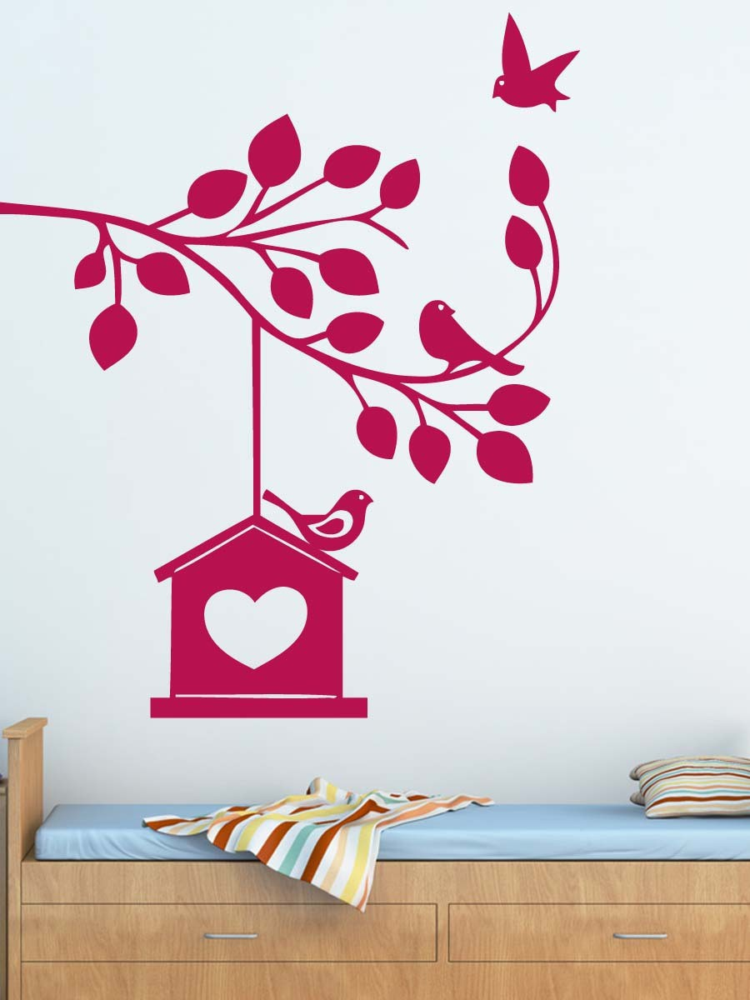

'Specifications of Doraemon Gift Family Ceramic Coffee Mug Multicolour Mug - 325 ml In The Box Sales Package Ceramic Coffee Mug General Type Mug Size in Number 9 inch Size Small'

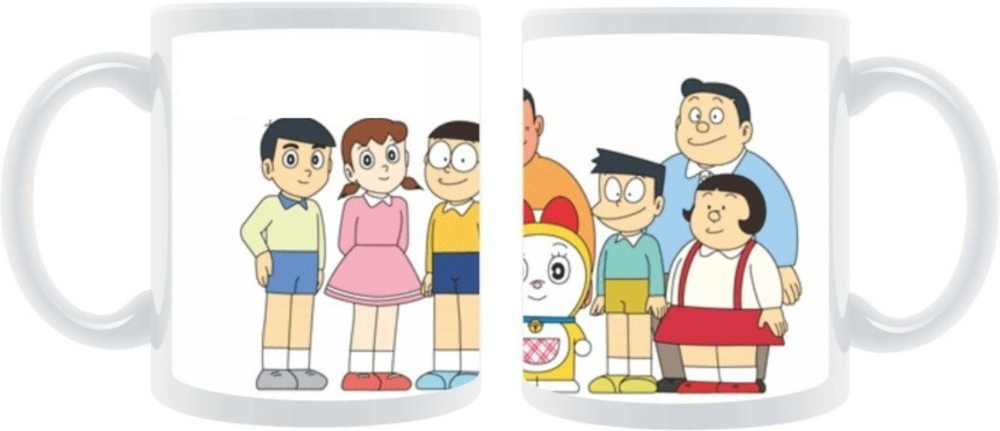

'Specifications of Like Analog Purple Clock Functions Alarm Yes General Suitable For Table Number of Batteries 1 Power Source Battery Display Features Backlight No Warranty 1 year manufacturers warranty Dimensions Weight 230 g Height 122 mm Width 37 mm Body Features Dial Shape Rectangle Dial Number of Display Hands 4 Display Hands Material Plastic Dial Color Purple In the Box Number of Contents in Sales Package Pack of 1 Sales Package 1 Table Clock'

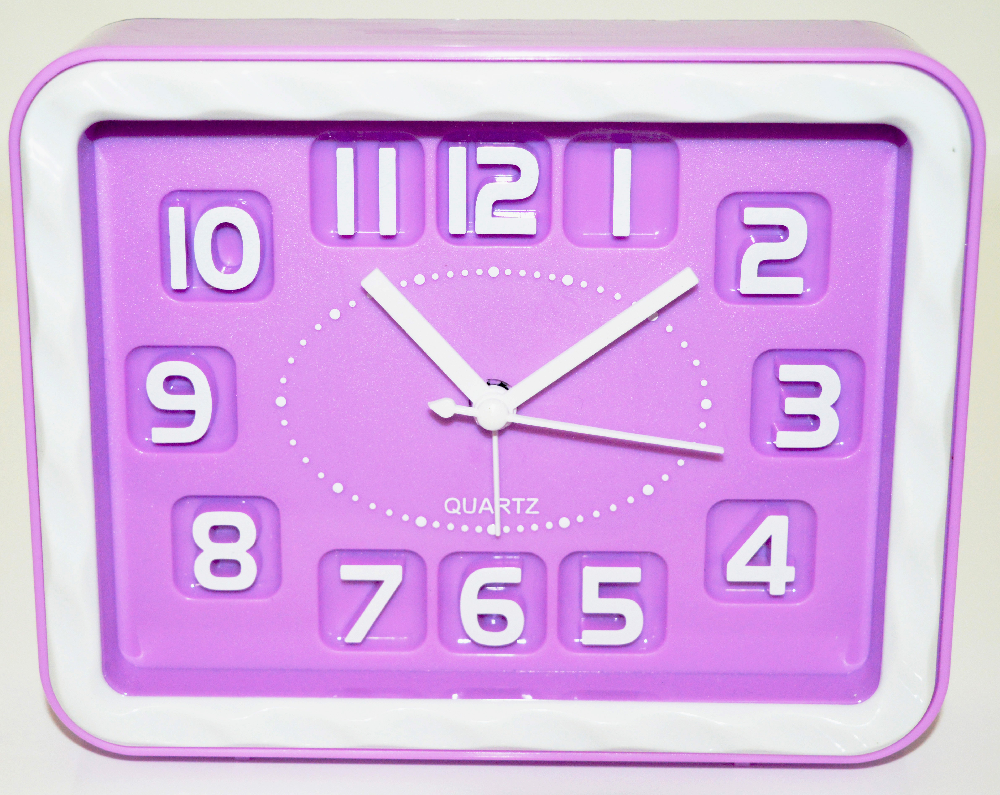

'Cocovey Metal Photo Frame (Photo Size - 6*4, 1 Photos)\r\n                         Price: Rs. 549\r\n\t\t\t\t\r\n\t\t\tAdd traditional and stylish look to your house with Cocovey handcrafted photo frames. This beautifully crafted photo frame is made of brass. Its traditional tribal and cultural design is unique and brings style to your home. Indian homes are getting stylish with time as there is more excitement towards interior home décor.Our company is an effort to perceive that excitement and help you choose your favorites from a wide range of such painstakingly pursued beautiful handicraft items; as they find their way from the skilled hands of craftsmen directly to that precious place in your abode.\r\nAdd traditional and stylish look to your house with Cocovey handcrafted photo frames. This beautifully crafted photo frame is made of brass. Its traditional tribal and cultural design is unique and brings style to your home. Indian homes are getting stylish with time as there is mor

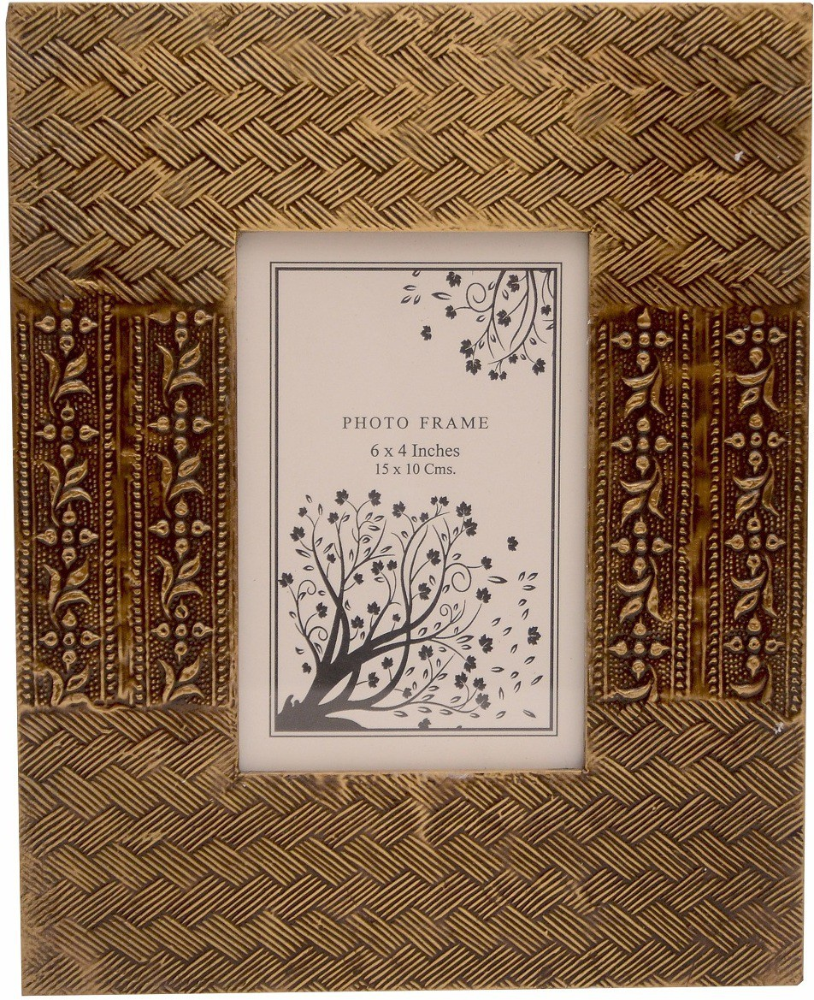

'Key Features of Eurospa Cotton Terry Face Towel Set Size: small Height: 9 inch GSM: 360,Eurospa Cotton Terry Face Towel Set (20 PIECE FACE TOWEL SET, Assorted) Price: Rs. 299 Eurospa brings to you an exclusively designed, 100% soft cotton towels of export quality. All our products have soft texture that takes care of your skin and gives you that enriched feeling you deserve. Eurospa has been exporting its bath towels to lot of renowned brands for last 10 years and is famous for its fine prints, absorbency, softness and durability. NOTE: Our product is 100% cotton, so it is susceptible to shrinkage. Product color may vary from the picture. Size may vary by ±3% WASH CARE: Wash in cold Water, Do not Iron, Do not Bleach, Flat dry, Wash before first use. SIZE- FACE TOWEL - 23 cms X 23 cms.,Specifications of Eurospa Cotton Terry Face Towel Set (20 PIECE FACE TOWEL SET, Assorted) Bath Towel Features Material Cotton Terry Design SHUVAM General Brand Eurospa GSM 360 Type Face Towel Set Model N

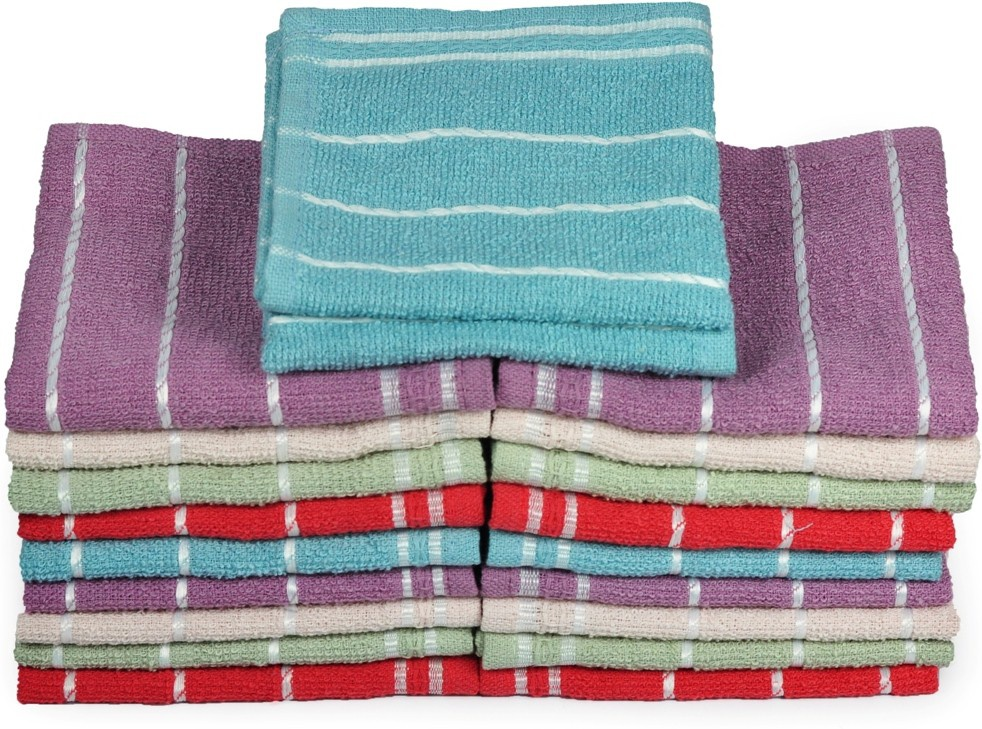

'Key Features of Tks Cotton Hair Towel Size: Medium Height: 56 inch GSM: 30 Usage: Daily Use,Specifications of Tks Cotton Hair Towel (1 Hair towel, Orange) Bath Towel Features Machine Washable Yes Material Cotton Design Checks General Brand Tks Type Hair Towel GSM 30 Model Name HAIR CARE Ideal For Women, Girls Model ID DSCO 125 Color Orange Size Medium Dimensions Length 56 inch Width 26 inch In the Box Sales Package 1 Hair towel'

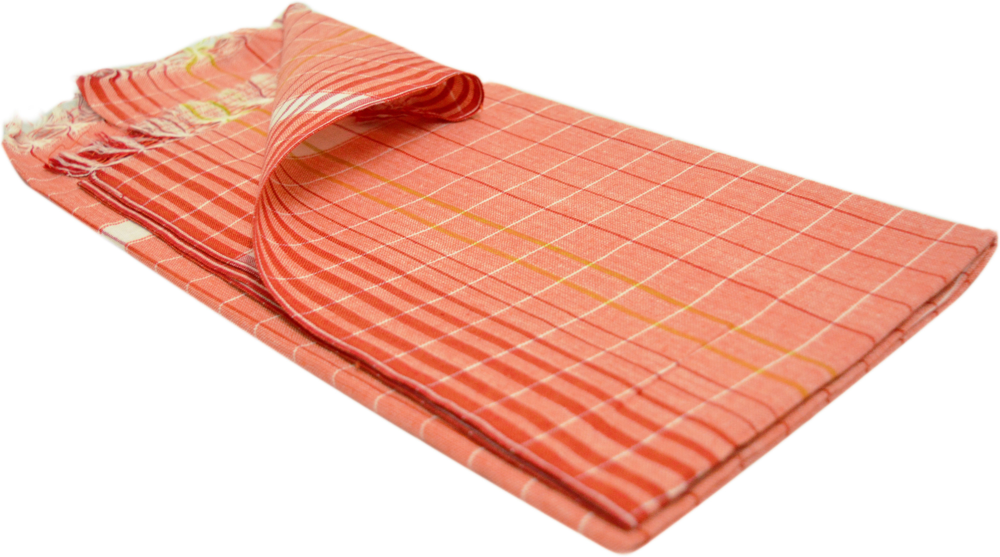

'Indha Craft Cloth Photo Frame (Photo Size - 12.7 X 17.8 cm, 1 Photos)\r\n                         Price: Rs. 132\r\n\t\t\t\t\r\n\t\t\tThe outer shell of this frame is made up of Polyster bland fabric and hard board Fabric and inner material is carbord. The photo of this frame is 5 x 3 inches.\r\nThe outer shell of this frame is made up of Polyster bland fabric and hard board Fabric and inner material is carbord. The photo of this frame is 5 x 3 inches.'

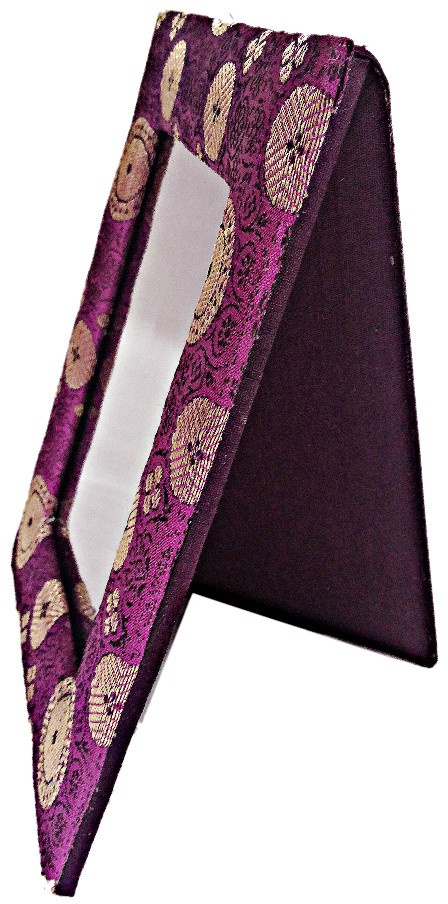

'Specifications of KDS SURGICAL Tripod Walking Stick In The Box 1 WALKING STICK General Brand KDS SURGICAL Foldable No Model Number Tripod Material Iron, Plastic Color Grey Height Adjustable Yes Dimensions Weight 400 g Length 91 cm'

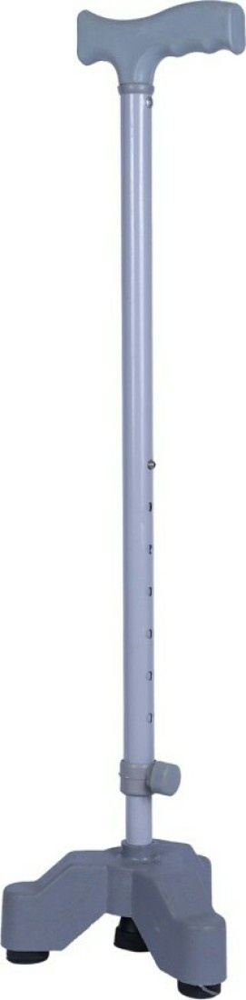

'Key Features of Reiki Crystal Products Showpiece  -  6 cm Singing Bowls Vastu Healing Aura Cleaning Home Cleaning Room Cleaning,Reiki Crystal Products Showpiece  -  6 cm (Brass, Brown, Gold) Price: Rs. 1,200 Singing Bowl is an amazing instrument to play and clean the negativities from a place. As in Hinduism we play shankh. Shankh disintegrates the negative energies from a place with sound vibrations. Singing Bowl is a Buddhist concept of disintegrating and cleaning the negative energies by sound waves. The main benefit of using a Singing Bowls is that it is very easy to play and handle. We should always rotate the striker / play the bowl clockwise. Singing Bowls amplifies any intention with which it is played. So we can use singing bowl to clean the place our homes, rooms, offices, shops from all kinds of negative energies and vibrations. We can charge the place with positive energies and much more. Use it regularly to experience its benefits. The singing bowls are available from a s

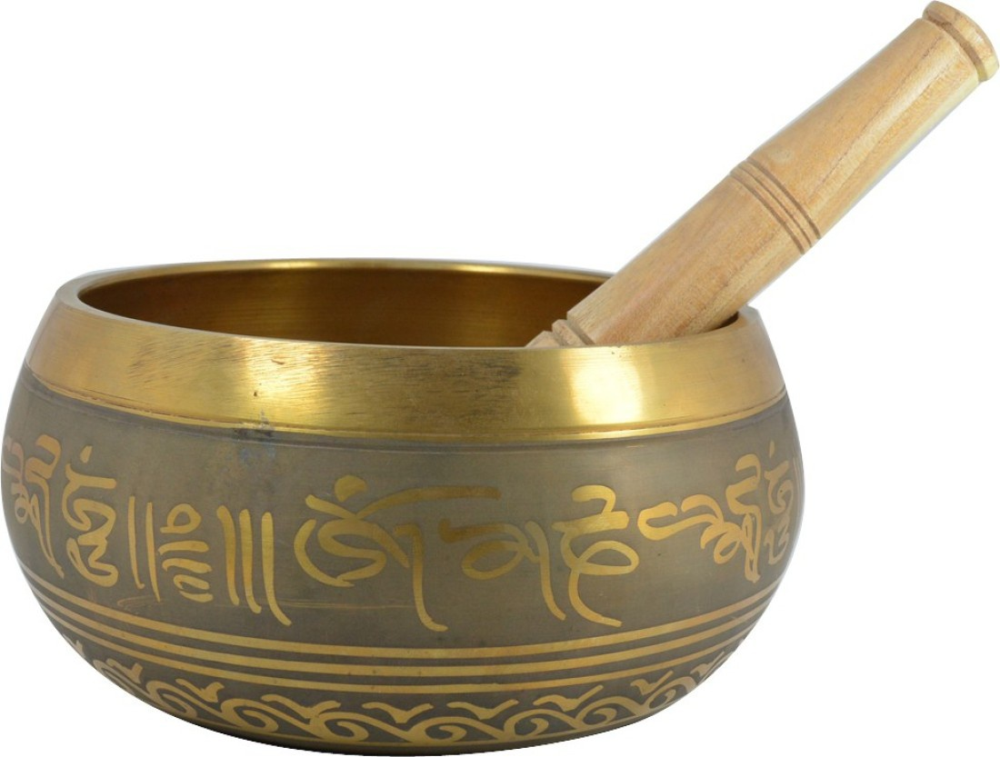

In [186]:
indices_wrong_test = indices_test[np.sum(wrong_predictions_test, axis=1) != 0]
for i in range(df_data.iloc[indices_test[np.sum(wrong_predictions_test, axis=1) != 0]].shape[0]):
    df_data.iloc[indices_wrong_test[i]]["description"]
    file = '/home/bento/P6/Data/Flipkart/Images/' + str(df_data.iloc[indices_wrong_test[i]]["image"])
    Image(file, width=100)

In [187]:
predictions_train = np.round(estimator.predict(X_train))
wrong_predictions_train = (predictions_train != dummy_train_y)

In [188]:
indices_wrong_train = indices_train[np.sum(wrong_predictions_train, axis=1) != 0]
for i in range(len(indices_wrong_train)):
    df_data.iloc[indices_wrong_train[i]]["description"]
    file = '/home/bento/P6/Data/Flipkart/Images/' + str(df_data.iloc[indices_wrong_train[i]]["image"])
    Image(file, width=100)

In [189]:
indices_wrong_train.shape

(0,)